
soyabean UAV leaf Disease Detection using CNNs and XAI using PyTorch This dataset and analysis has been published in Technology Innovation Hub, Indian Statistical Institute Kolkata, 18 December 2024


This notebook demonstrates:

Custom CNN model from scratch for leaf disease detection.

Transfer learning models (VGG16, Resnet50, MobileNetV2, EfficientNet, DenseNet121, Densenet201, Resnet152).

Training with dataset augmentation and early stopping.

Visualization of training and validation loss curves.

Model evaluation with precision, recall, and F1-score.

XAI techniques: Grad-CAM, Grad-CAM++, Eigen-CAM, and LIME for model interpretation.

# CNN Models

# Import library

In [ ]:
!pip install git+https://github.com/jacobgil/pytorch-grad-cam.git


!pip install lime

  Cloning https://github.com/jacobgil/pytorch-grad-cam.git to /tmp/pip-req-build-b2qpnhxc
  Running command git clone --filter=blob:none --quiet https://github.com/jacobgil/pytorch-grad-cam.git /tmp/pip-req-build-b2qpnhxc
  Resolved https://github.com/jacobgil/pytorch-grad-cam.git to commit 781dbc0d16ffa95b6d18b96b7b829840a82d93d1
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
from torchvision import datasets, transforms, models
from torchvision.transforms import ToTensor
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from pytorch_grad_cam import GradCAM, GradCAMPlusPlus, EigenCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
from lime import lime_image
import zipfile
import os
from tqdm import tqdm  # Import tqdm for progress bars

# Load and Prepare the Dataset

In [ ]:
transform_train = transforms.Compose([
    transforms.RandomResizedCrop(224),      # Resize and crop for augmentation
    transforms.RandomHorizontalFlip(),      # Augmentation
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

transform_test = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# Load dataset
dataset = datasets.ImageFolder(root="/kaggle/input/soyabean-uav/Soyabean_UAV-Based_Image_Dataset", transform=transform_train)
train_size = int(0.7 * len(dataset))
val_size = int(0.2 * len(dataset))
test_size = len(dataset) - train_size - val_size
train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

# Apply test transformation to validation and test sets

val_dataset.dataset.transform = transform_test
test_dataset.dataset.transform = transform_test

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# Visualize Example Images for Each Class

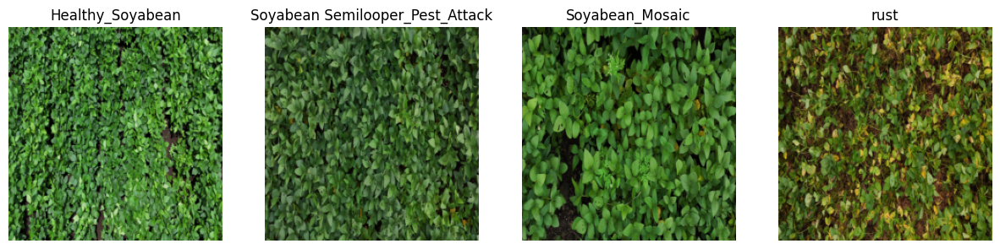

In [ ]:
# Display a sample image from each class
class_names = dataset.classes
num_classes = len(class_names)

fig, axs = plt.subplots(1, num_classes, figsize=(15, 5))

# Dictionary to track displayed images per class
displayed_classes = {class_name: False for class_name in class_names}

# Loop through the data to get at least one sample from each class
for images, labels in train_loader:
    for img, label in zip(images, labels):
        class_name = class_names[label]
        # Display the image if not already displayed for this class
        if not displayed_classes[class_name]:
            img = img.permute(1, 2, 0).numpy()
            img = (img * 0.5) + 0.5  # Unnormalize the image
            axs[label].imshow(np.clip(img, 0, 1))  # Clip to valid range
            axs[label].set_title(class_name)
            axs[label].axis('off')
            displayed_classes[class_name] = True  # Mark as displayed

        # Break if all classes are displayed
        if all(displayed_classes.values()):
            break

    if all(displayed_classes.values()):
        break

plt.show()


# Define a Custom CNN Model

In [ ]:
class CustomCNN(nn.Module):
    def __init__(self):
        super(CustomCNN, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1)
        self.conv5 = nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1)  # New Conv Layer 5
        self.conv6 = nn.Conv2d(512, 1024, kernel_size=3, stride=1, padding=1)  # New Conv Layer 6

        # After 6 max-pooling layers, the feature map size is 1024x3x3 (not 7x7)
        self.fc1 = nn.Linear(1024 * 3 * 3, 512)  # Adjusted input size
        self.fc2 = nn.Linear(512, 256)
        self.fc3 = nn.Linear(256, 128)
        self.fc4 = nn.Linear(128, 64)    # New Fully Connected Layer 4
        self.fc5 = nn.Linear(64, 32)     # New Fully Connected Layer 5
        self.fc6 = nn.Linear(32, len(class_names))  # Final Output Layer (number of classes)
        self.dropout = nn.Dropout(0.1)

    def forward(self, x):
        # Convolutional layers
        x = torch.relu(self.conv1(x))
        x = torch.max_pool2d(x, 2)  # [B, 32, 112, 112]
        x = torch.relu(self.conv2(x))
        x = torch.max_pool2d(x, 2)  # [B, 64, 56, 56]
        x = torch.relu(self.conv3(x))
        x = torch.max_pool2d(x, 2)  # [B, 128, 28, 28]
        x = torch.relu(self.conv4(x))
        x = torch.max_pool2d(x, 2)  # [B, 256, 14, 14]

        # New convolutional layers (conv5 and conv6)
        x = torch.relu(self.conv5(x))  # [B, 512, 14, 14]
        x = torch.max_pool2d(x, 2)     # [B, 512, 7, 7]
        x = torch.relu(self.conv6(x))  # [B, 1024, 7, 7]
        x = torch.max_pool2d(x, 2)     # [B, 1024, 3, 3]

        # Flatten the output correctly based on the size [B, 1024, 3, 3]
        x = x.view(-1, 1024 * 3 * 3)  # Correct flattened size [B, 1024*3*3]

        # Fully connected layers with dropout and ReLU activations
        x = self.dropout(torch.relu(self.fc1(x)))
        x = self.dropout(torch.relu(self.fc2(x)))
        x = self.dropout(torch.relu(self.fc3(x)))
        x = self.dropout(torch.relu(self.fc4(x)))  # Apply ReLU and dropout to fc4
        x = self.dropout(torch.relu(self.fc5(x)))  # Apply ReLU and dropout to fc5

        # Final output layer
        return self.fc6(x)  # Output layer (final predictions)


# Transfer Learning Models

# Using pretrained models from PyTorch.

In [ ]:
import torch.nn as nn
from torchvision import models

def get_transfer_model(model_name, num_classes):
    if model_name == "vgg16":
        model = models.vgg16(pretrained=True)
        model.classifier[6] = nn.Linear(model.classifier[6].in_features, num_classes)

    elif model_name == "mobilenet_v2":
        model = models.mobilenet_v2(pretrained=True)
        model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)

    elif model_name == "efficientnet_b3":
        model = models.efficientnet_b3(pretrained=True)
        model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)

    elif model_name == "densenet121":
        model = models.densenet121(pretrained=True)
        model.classifier = nn.Linear(model.classifier.in_features, num_classes)

    elif model_name == "resnet152":
        model = models.resnet152(pretrained=True)
        model.fc = nn.Linear(model.fc.in_features, num_classes)

    elif model_name == "densenet201":
        model = models.densenet201(pretrained=True)
        model.classifier = nn.Linear(model.classifier.in_features, num_classes)



    elif model_name == "resnet50":
        model = models.resnet50(pretrained=True)
        model.fc = nn.Linear(model.fc.in_features, num_classes)  # Modify the final fully connected layer

    else:
        raise ValueError(f"Model '{model_name}' not supported. Choose from vgg16, mobilenet_v2, efficientnet_b0, densenet121, inception_v3, resnet50.")

    return model


# Training and Early Stopping

In [ ]:
class EarlyStopping:

    def __init__(self, patience=5):

        self.patience = patience
        self.counter = 0
        self.best_loss = np.inf

    def check_early_stop(self, val_loss):
        if val_loss < self.best_loss:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                return True
        return False


# Training the CNN model

In [ ]:
num_epochs = 50  # Define the number of training epochs

model = CustomCNN()  # Initialize the model; can replace with a transfer model like get_transfer_model()

criterion = nn.CrossEntropyLoss()  # Loss function

optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizer with learning rate

early_stopping = EarlyStopping(patience=5)  # Initialize early stopping with patience

train_losses, val_losses = [], []  # Lists to store training and validation losses per epoch

# Loop over epochs
for epoch in range(num_epochs):

    print(f"Epoch {epoch+1}/{num_epochs}")
    # Training phase

    model.train()  # Set model to training mode

    train_loss = 0  # Initialize cumulative training loss for the epoch

    # Loop over training data with tqdm progress bar
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        outputs = model(images)  # Forward pass
        loss = criterion(outputs, labels)  # Compute loss
        optimizer.zero_grad()  # Clear previous gradients
        loss.backward()  # Backward pass (calculate gradients)
        optimizer.step()  # Update weights
        train_loss += loss.item()  # Accumulate the training loss

    # Validation phase
    model.eval()  # Set model to evaluation mode
    val_loss = 0  # Initialize cumulative validation loss for the epoch
    with torch.no_grad():  # Disable gradient calculation for validation

        # Loop over validation data with tqdm progress bar
        for images, labels in tqdm(val_loader, desc="Validation", leave=False):
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss
            val_loss += loss.item()  # Accumulate the validation loss

    # Calculate average losses and append to lists
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    # Early stopping check
    if early_stopping.check_early_stop(avg_val_loss):
        print("Early stopping triggered.")
        break


Epoch 1/50


Train Loss: 1.3099, Validation Loss: 1.3253
Epoch 2/50


Train Loss: 1.0110, Validation Loss: 0.7002
Epoch 3/50


Train Loss: 0.6584, Validation Loss: 0.6084
Epoch 4/50


Train Loss: 0.6252, Validation Loss: 0.5790
Epoch 5/50


Train Loss: 0.5507, Validation Loss: 0.4636
Epoch 6/50


Train Loss: 0.4861, Validation Loss: 0.4927
Epoch 7/50


Train Loss: 0.3877, Validation Loss: 0.6292
Epoch 8/50


Train Loss: 0.3426, Validation Loss: 0.3916
Epoch 9/50


Train Loss: 0.3410, Validation Loss: 0.2686
Epoch 10/50


Train Loss: 0.2378, Validation Loss: 0.2640
Epoch 11/50


Train Loss: 0.3263, Validation Loss: 0.1976
Epoch 12/50


Train Loss: 0.2343, Validation Loss: 0.1890
Epoch 13/50


Train Loss: 0.2136, Validation Loss: 0.2056
Epoch 14/50


Train Loss: 0.2375, Validation Loss: 0.2305
Epoch 15/50


Train Loss: 0.1832, Validation Loss: 0.2669
Epoch 16/50


Train Loss: 0.2594, Validation Loss: 0.2076
Epoch 17/50


Train Loss: 0.1471, Validation Loss: 0.1105
Epoch 18/50


Train Loss: 0.4878, Validation Loss: 0.3205
Epoch 19/50


Train Loss: 0.2297, Validation Loss: 0.2160
Epoch 20/50


Train Loss: 0.1412, Validation Loss: 0.1440
Epoch 21/50


Train Loss: 0.2408, Validation Loss: 0.4605
Epoch 22/50


Train Loss: 0.3586, Validation Loss: 0.2846
Early stopping triggered.


# Path Defining

In [ ]:
# Define a path for saving the model
model_save_path = "custom_cnn_model.pth"  # You can specify a different path or filename

# Save the model after training completes or early stopping is triggered
torch.save(model.state_dict(), model_save_path)

print(f"Model saved to {model_save_path}")

Model saved to custom_cnn_model.pth


# show plot for CNN

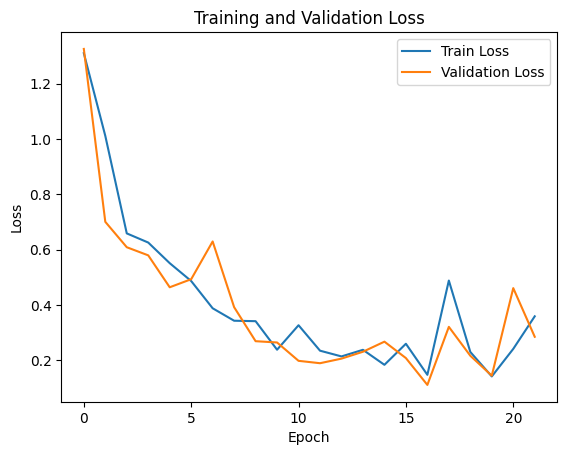

In [ ]:
# Plotting loss curves
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title("Training and Validation Loss")
plt.show()

# Model Evaluation and Metrics Calculation

In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Define device and move model to it
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)  # This line was missing - move model to GPU

# Move model to evaluation mode
model.eval()

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Run inference
with torch.no_grad():  # Disable gradient calculation for faster inference
    for images, labels in test_loader:
        # Move images and labels to the device
        images, labels = images.to(device), labels.to(device)

        # Forward pass
        outputs = model(images)

        # Get predictions (choose the class with the highest logit score)
        _, predicted = torch.max(outputs, 1)

        # Append predictions and true labels to lists
        all_preds.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Calculate evaluation metrics
accuracy = accuracy_score(all_labels, all_preds)
precision = precision_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
f1 = f1_score(all_labels, all_preds, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

Accuracy: 89.47%
Precision: 0.8902
Recall: 0.8947
F1 Score: 0.8910


# Confusion Matrix for CNN

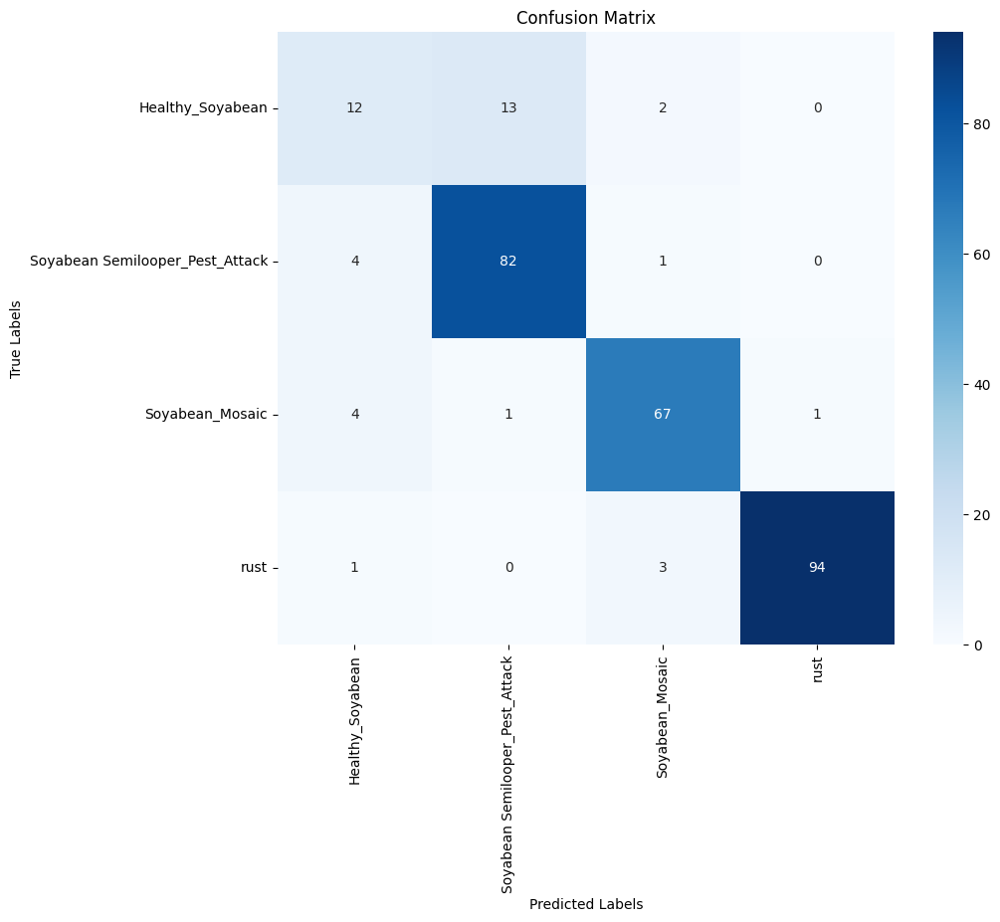


Class: Healthy_Soyabean
Precision: 0.5714
Recall: 0.4444
F1 Score: 0.5000

Class: Soyabean Semilooper_Pest_Attack
Precision: 0.8542
Recall: 0.9425
F1 Score: 0.8962

Class: Soyabean_Mosaic
Precision: 0.9178
Recall: 0.9178
F1 Score: 0.9178

Class: rust
Precision: 0.9895
Recall: 0.9592
F1 Score: 0.9741


In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Code to calculate predictions from previous example
# ...

# Add confusion matrix visualization
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']
cm = confusion_matrix(all_labels, all_preds)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

# Calculate per-class metrics
per_class_precision = precision_score(all_labels, all_preds, average=None)
per_class_recall = recall_score(all_labels, all_preds, average=None)
per_class_f1 = f1_score(all_labels, all_preds, average=None)

# Display per-class metrics
for i, class_name in enumerate(class_names):
    print(f"\nClass: {class_name}")
    print(f"Precision: {per_class_precision[i]:.4f}")
    print(f"Recall: {per_class_recall[i]:.4f}")
    print(f"F1 Score: {per_class_f1[i]:.4f}")

# Using AMP with Custom Model

In [ ]:
from tqdm import tqdm  # Import tqdm for progress bars
from torch.cuda.amp import autocast, GradScaler  # Import AMP utilities

# Set number of epochs and initialize variables

num_epochs = 50  # Define the number of training epochs

model = CustomCNN().to('cuda')  # Move model to GPU

criterion = nn.CrossEntropyLoss()  # Loss function

optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizer with learning rate

early_stopping = EarlyStopping(patience=5)  # Initialize early stopping with patience

train_losses, val_losses = [], []  # Lists to store training and validation losses per epoch

# Initialize GradScaler for AMP
scaler = GradScaler()
# Loop over epochs
for epoch in range(num_epochs):

    print(f"Epoch {epoch+1}/{num_epochs}")
    # Training phase
    model.train()  # Set model to training mode
    train_loss = 0  # Initialize cumulative training loss for the epoch
    # Loop over training data with tqdm progress bar
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU
        optimizer.zero_grad()  # Clear previous gradients
        with autocast():  # Use AMP for mixed-precision calculations
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss

        # Scale loss to avoid underflow for float16
        scaler.scale(loss).backward()  # Backward pass with scaled loss
        scaler.step(optimizer)  # Optimizer step
        scaler.update()  # Update the scaler for next iteration
        train_loss += loss.item()  # Accumulate the training loss

    # Validation phase
    model.eval()  # Set model to evaluation mode
    val_loss = 0  # Initialize cumulative validation loss for the epoch
    with torch.no_grad():  # Disable gradient calculation for validation
        # Loop over validation data with tqdm progress bar
        for images, labels in tqdm(val_loader, desc="Validation", leave=False):
            images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU
            with autocast():  # Use AMP for mixed-precision calculations
                outputs = model(images)  # Forward pass
                loss = criterion(outputs, labels)  # Compute loss
            val_loss += loss.item()  # Accumulate the validation loss

    # Calculate average losses and append to lists
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    # Early stopping check
    if early_stopping.check_early_stop(avg_val_loss):
        print("Early stopping triggered.")
        break



/tmp/ipykernel_36/1563804058.py:19: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


Epoch 1/50


Training:   0%|          | 0/125 [00:00<?, ?it/s]/tmp/ipykernel_36/1563804058.py:31: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations
Validation:   0%|          | 0/36 [00:00<?, ?it/s]         /tmp/ipykernel_36/1563804058.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations


Train Loss: 0.9171, Validation Loss: 0.8936
Epoch 2/50


Train Loss: 0.7156, Validation Loss: 0.6484
Epoch 3/50


Train Loss: 0.5673, Validation Loss: 0.6254
Epoch 4/50


Train Loss: 0.5617, Validation Loss: 0.5035
Epoch 5/50


Train Loss: 0.5879, Validation Loss: 0.7654
Epoch 6/50


Train Loss: 0.5266, Validation Loss: 0.4952
Epoch 7/50


Train Loss: 0.4531, Validation Loss: 0.4143
Epoch 8/50


Train Loss: 0.3930, Validation Loss: 0.5772
Epoch 9/50


Train Loss: 0.5952, Validation Loss: 0.4866
Epoch 10/50


Train Loss: 0.5123, Validation Loss: 0.3700
Epoch 11/50


Train Loss: 0.4667, Validation Loss: 0.3776
Epoch 12/50


Train Loss: 0.5361, Validation Loss: 0.3943
Epoch 13/50


Train Loss: 0.4822, Validation Loss: 0.4386
Epoch 14/50


Train Loss: 0.4458, Validation Loss: 0.3703
Epoch 15/50


Train Loss: 0.3112, Validation Loss: 0.2750
Epoch 16/50


Train Loss: 0.2902, Validation Loss: 0.4279
Epoch 17/50


Train Loss: 0.4382, Validation Loss: 0.2658
Epoch 18/50


Train Loss: 0.3380, Validation Loss: 0.6225
Epoch 19/50


Train Loss: 0.2925, Validation Loss: 0.4927
Epoch 20/50


Train Loss: 0.3640, Validation Loss: 0.4096
Epoch 21/50


Train Loss: 0.2922, Validation Loss: 0.3882
Epoch 22/50


Train Loss: 0.2658, Validation Loss: 0.4627
Early stopping triggered.


# Path Defining

In [ ]:
# Define a path for saving the model
model_save_path = "custom_cnn_model.pth"  # You can specify a different path or filename

# Save the model after training completes or early stopping is triggered
torch.save(model.state_dict(), model_save_path)

print(f"Model saved to {model_save_path}")

Model saved to custom_cnn_model.pth


# Show plot for Using AMP with Custom Model

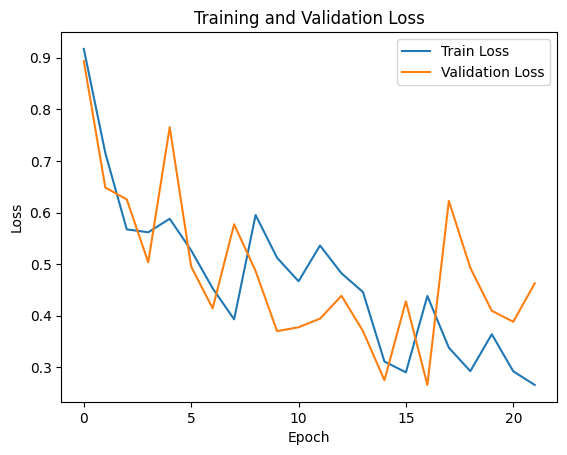

In [ ]:
# Plotting loss curves
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title("Training and Validation Loss")
plt.show()

# Model Evalution for custom CNN using AMP

In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Define device and move model to it
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)  # This line was missing - move model to GPU

# Move model to evaluation mode
model.eval()

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Run inference
with torch.no_grad():  # Disable gradient calculation for faster inference
    for images, labels in test_loader:
        # Move images and labels to the device
        images, labels = images.to(device), labels.to(device)

        # Forward pass
        outputs = model(images)

        # Get predictions (choose the class with the highest logit score)
        _, predicted = torch.max(outputs, 1)

        # Append predictions and true labels to lists
        all_preds.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Calculate evaluation metrics
accuracy = accuracy_score(all_labels, all_preds)
precision = precision_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
f1 = f1_score(all_labels, all_preds, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

Accuracy: 83.16%
Precision: 0.7706
Recall: 0.8316
F1 Score: 0.7953


# Confusion Matrix

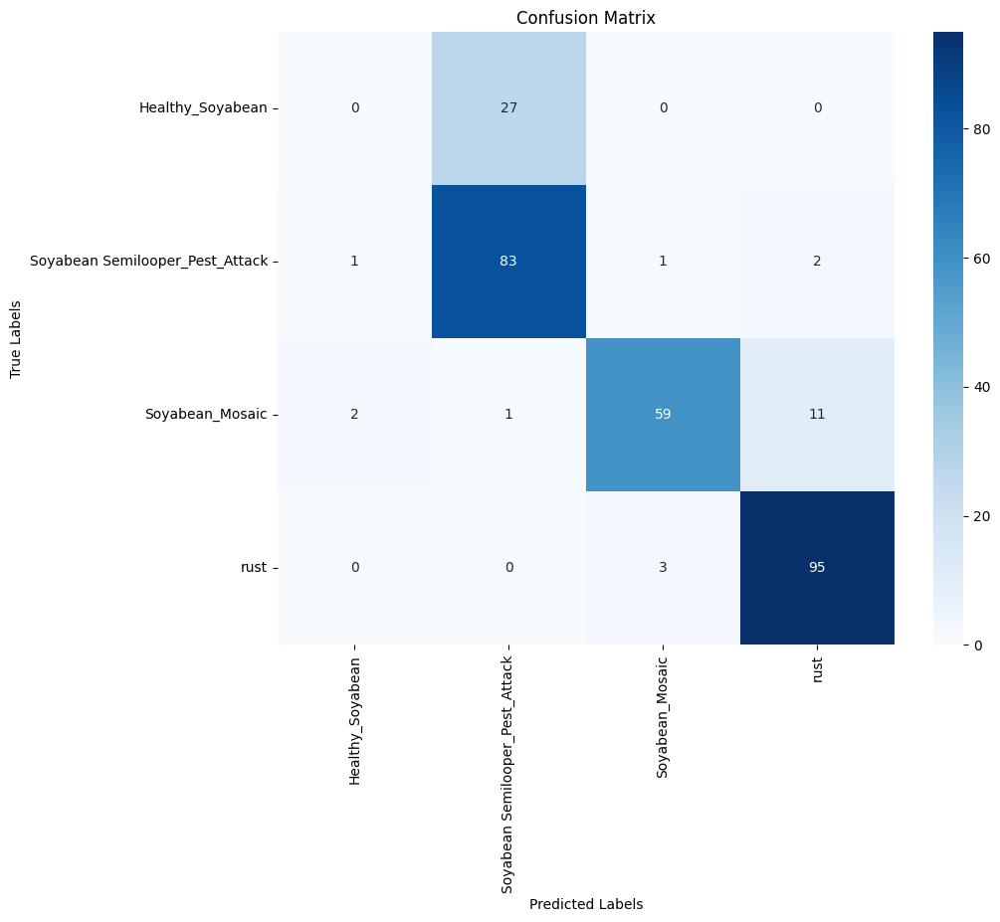


Class: Healthy_Soyabean
Precision: 0.0000
Recall: 0.0000
F1 Score: 0.0000

Class: Soyabean Semilooper_Pest_Attack
Precision: 0.7477
Recall: 0.9540
F1 Score: 0.8384

Class: Soyabean_Mosaic
Precision: 0.9365
Recall: 0.8082
F1 Score: 0.8676

Class: rust
Precision: 0.8796
Recall: 0.9694
F1 Score: 0.9223


In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Code to calculate predictions from previous example
# ...

# Add confusion matrix visualization
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']
cm = confusion_matrix(all_labels, all_preds)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

# Calculate per-class metrics
per_class_precision = precision_score(all_labels, all_preds, average=None)
per_class_recall = recall_score(all_labels, all_preds, average=None)
per_class_f1 = f1_score(all_labels, all_preds, average=None)

# Display per-class metrics
for i, class_name in enumerate(class_names):
    print(f"\nClass: {class_name}")
    print(f"Precision: {per_class_precision[i]:.4f}")
    print(f"Recall: {per_class_recall[i]:.4f}")
    print(f"F1 Score: {per_class_f1[i]:.4f}")

# Transfer learning using Restnet50

In [ ]:
from tqdm import tqdm  # Import tqdm for progress bars
from torch.cuda.amp import autocast, GradScaler  # Import AMP utilities

# Set number of epochs and initialize variables
num_epochs = 50  # Define the number of training epochs

model = get_transfer_model('resnet50', num_classes).to('cuda')
criterion = nn.CrossEntropyLoss()  # Loss function

optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizer with learning rate

early_stopping = EarlyStopping(patience=5)  # Initialize early stopping with patience

train_losses, val_losses = [], []  # Lists to store training and validation losses per epoch

# Initialize GradScaler for AMP
scaler = GradScaler()
# Loop over epochs
for epoch in range(num_epochs):

    print(f"Epoch {epoch+1}/{num_epochs}")
    # Training phase
    model.train()  # Set model to training mode
    train_loss = 0  # Initialize cumulative training loss for the epoch
    # Loop over training data with tqdm progress bar
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU

        optimizer.zero_grad()  # Clear previous gradients

        with autocast():  # Use AMP for mixed-precision calculations
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss

        # Scale loss to avoid underflow for float16
        scaler.scale(loss).backward()  # Backward pass with scaled loss
        scaler.step(optimizer)  # Optimizer step
        scaler.update()  # Update the scaler for next iteration
        train_loss += loss.item()  # Accumulate the training loss

    # Validation phase
    model.eval()  # Set model to evaluation mode
    val_loss = 0  # Initialize cumulative validation loss for the epoch
    with torch.no_grad():  # Disable gradient calculation for validation
        # Loop over validation data with tqdm progress bar
        for images, labels in tqdm(val_loader, desc="Validation", leave=False):
            images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU
            with autocast():  # Use AMP for mixed-precision calculations
                outputs = model(images)  # Forward pass
                loss = criterion(outputs, labels)  # Compute loss
            val_loss += loss.item()  # Accumulate the validation loss

    # Calculate average losses and append to lists
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    # Early stopping check
    if early_stopping.check_early_stop(avg_val_loss):
        print("Early stopping triggered.")
        break



# Save the model
torch.save(model.state_dict(), 'transfer_learning_resnet50.pth')
print("Model saved as 'transfer_learning_resnet50.pth'")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 198MB/s]
/tmp/ipykernel_36/2846278931.py:17: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


Epoch 1/50


Training:   0%|          | 0/125 [00:00<?, ?it/s]/tmp/ipykernel_36/2846278931.py:31: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations
Validation:   0%|          | 0/36 [00:00<?, ?it/s]         /tmp/ipykernel_36/2846278931.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations


Train Loss: 0.4155, Validation Loss: 0.1152
Epoch 2/50


Train Loss: 0.2151, Validation Loss: 0.5163
Epoch 3/50


Train Loss: 0.1476, Validation Loss: 0.1084
Epoch 4/50


Train Loss: 0.1310, Validation Loss: 0.0630
Epoch 5/50


Train Loss: 0.0716, Validation Loss: 0.0424
Epoch 6/50


Train Loss: 0.1235, Validation Loss: 10.1434
Epoch 7/50


Train Loss: 0.1527, Validation Loss: 0.0568
Epoch 8/50


Train Loss: 0.0925, Validation Loss: 0.0331
Epoch 9/50


Train Loss: 0.0583, Validation Loss: 0.1102
Epoch 10/50


Train Loss: 0.0495, Validation Loss: 0.0548
Epoch 11/50


Train Loss: 0.0295, Validation Loss: 0.1286
Epoch 12/50


Train Loss: 0.0848, Validation Loss: 9.3067
Epoch 13/50


Train Loss: 0.1193, Validation Loss: 0.0769
Early stopping triggered.
Model saved as 'transfer_learning_resnet50.pth'


# Loss Curve for ResNet50

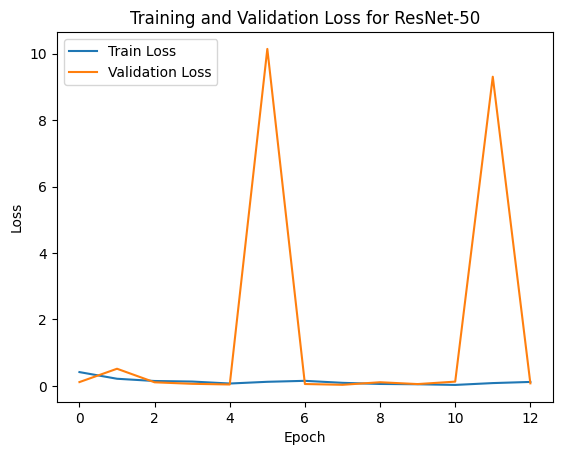

In [ ]:
# Plotting loss curves

plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title("Training and Validation Loss for ResNet-50")
plt.show()

# Model Evaluation and Metrics Calculation

In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Move model to evaluation mode
model.eval()

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Run inference
with torch.no_grad():  # Disable gradient calculation for faster inference
    for images, labels in test_loader:
        # Move images and labels to the same device as the model (GPU)
        images, labels = images.to('cuda'), labels.to('cuda')

        # Forward pass
        outputs = model(images)

        # Get predictions (choose the class with the highest logit score)
        _, predicted = torch.max(outputs, 1)

        # Append predictions and true labels to lists
        all_preds.extend(predicted.cpu().numpy())  # Move to CPU and convert to numpy
        all_labels.extend(labels.cpu().numpy())    # Move to CPU and convert to numpy

# Calculate evaluation metrics
accuracy = accuracy_score(all_labels, all_preds)
precision = precision_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
f1 = f1_score(all_labels, all_preds, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")


Accuracy: 96.84%
Precision: 0.9691
Recall: 0.9684
F1 Score: 0.9684


# Transfer Learning using VGG16

In [ ]:
from tqdm import tqdm  # Import tqdm for progress bars
from torch.cuda.amp import autocast, GradScaler  # Import AMP utilities

# Set number of epochs and initialize variables
num_epochs = 50  # Define the number of training epochs

model = get_transfer_model('vgg16', num_classes).to('cuda')
criterion = nn.CrossEntropyLoss()  # Loss function

optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizer with learning rate

early_stopping = EarlyStopping(patience=5)  # Initialize early stopping with patience

train_losses, val_losses = [], []  # Lists to store training and validation losses per epoch

# Initialize GradScaler for AMP
scaler = GradScaler()
# Loop over epochs
for epoch in range(num_epochs):

    print(f"Epoch {epoch+1}/{num_epochs}")
    # Training phase
    model.train()  # Set model to training mode
    train_loss = 0  # Initialize cumulative training loss for the epoch
    # Loop over training data with tqdm progress bar
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU

        optimizer.zero_grad()  # Clear previous gradients

        with autocast():  # Use AMP for mixed-precision calculations
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss

        # Scale loss to avoid underflow for float16
        scaler.scale(loss).backward()  # Backward pass with scaled loss
        scaler.step(optimizer)  # Optimizer step
        scaler.update()  # Update the scaler for next iteration
        train_loss += loss.item()  # Accumulate the training loss

    # Validation phase
    model.eval()  # Set model to evaluation mode
    val_loss = 0  # Initialize cumulative validation loss for the epoch
    with torch.no_grad():  # Disable gradient calculation for validation
        # Loop over validation data with tqdm progress bar
        for images, labels in tqdm(val_loader, desc="Validation", leave=False):
            images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU
            with autocast():  # Use AMP for mixed-precision calculations
                outputs = model(images)  # Forward pass
                loss = criterion(outputs, labels)  # Compute loss
            val_loss += loss.item()  # Accumulate the validation loss

    # Calculate average losses and append to lists
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    # Early stopping check
    if early_stopping.check_early_stop(avg_val_loss):
        print("Early stopping triggered.")
        break



# Save the model
torch.save(model.state_dict(), 'transfer_learning_vgg16.pth')
print("Model saved as 'transfer_learning_vgg16.pth'")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 210MB/s] 
/tmp/ipykernel_36/537504019.py:17: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


Epoch 1/50


Training:   0%|          | 0/125 [00:00<?, ?it/s]/tmp/ipykernel_36/537504019.py:31: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations
Validation:   0%|          | 0/36 [00:00<?, ?it/s]         /tmp/ipykernel_36/537504019.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations


Train Loss: 1.9721, Validation Loss: 1.3131
Epoch 2/50


Train Loss: 1.3132, Validation Loss: 1.3110
Epoch 3/50


Train Loss: 1.3177, Validation Loss: 1.3153
Epoch 4/50


Train Loss: 1.3133, Validation Loss: 1.3136
Epoch 5/50


Train Loss: 1.3130, Validation Loss: 1.3140
Epoch 6/50


Train Loss: 1.3164, Validation Loss: 1.3195
Epoch 7/50


Train Loss: 1.3151, Validation Loss: 1.3269
Early stopping triggered.
Model saved as 'transfer_learning_vgg16.pth'


# Loss curve for vgg16

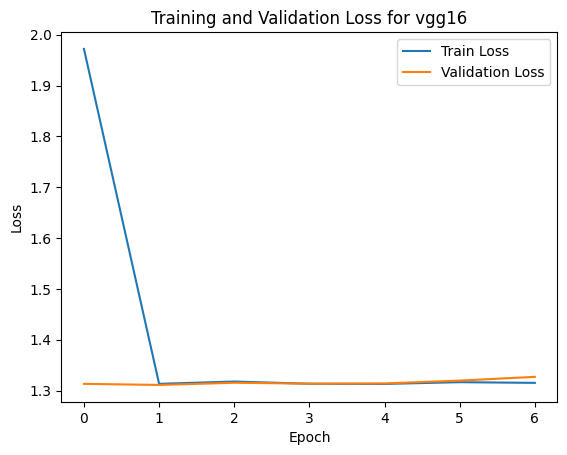

In [ ]:
# Plotting loss curves

plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title("Training and Validation Loss for vgg16")
plt.show()

# Model Evaluation and Metrics Calculation

In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Move model to evaluation mode
model.eval()

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Run inference
with torch.no_grad():  # Disable gradient calculation for faster inference
    for images, labels in test_loader:
        # Move images and labels to the same device as the model (GPU)
        images, labels = images.to('cuda'), labels.to('cuda')

        # Forward pass
        outputs = model(images)

        # Get predictions (choose the class with the highest logit score)
        _, predicted = torch.max(outputs, 1)

        # Append predictions and true labels to lists
        all_preds.extend(predicted.cpu().numpy())  # Move to CPU and convert to numpy
        all_labels.extend(labels.cpu().numpy())    # Move to CPU and convert to numpy

# Calculate evaluation metrics
accuracy = accuracy_score(all_labels, all_preds)
precision = precision_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
f1 = f1_score(all_labels, all_preds, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")


Accuracy: 34.39%
Precision: 0.1182
Recall: 0.3439
F1 Score: 0.1760


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# Transfer learning using Mobilenet_v2

In [ ]:
from tqdm import tqdm  # Import tqdm for progress bars
from torch.cuda.amp import autocast, GradScaler  # Import AMP utilities

# Set number of epochs and initialize variables
num_epochs = 50  # Define the number of training epochs

model = get_transfer_model('mobilenet_v2', num_classes).to('cuda')
criterion = nn.CrossEntropyLoss()  # Loss function

optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizer with learning rate

early_stopping = EarlyStopping(patience=5)  # Initialize early stopping with patience

train_losses, val_losses = [], []  # Lists to store training and validation losses per epoch

# Initialize GradScaler for AMP
scaler = GradScaler()
# Loop over epochs
for epoch in range(num_epochs):

    print(f"Epoch {epoch+1}/{num_epochs}")
    # Training phase
    model.train()  # Set model to training mode
    train_loss = 0  # Initialize cumulative training loss for the epoch
    # Loop over training data with tqdm progress bar
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU

        optimizer.zero_grad()  # Clear previous gradients

        with autocast():  # Use AMP for mixed-precision calculations
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss

        # Scale loss to avoid underflow for float16
        scaler.scale(loss).backward()  # Backward pass with scaled loss
        scaler.step(optimizer)  # Optimizer step
        scaler.update()  # Update the scaler for next iteration
        train_loss += loss.item()  # Accumulate the training loss

    # Validation phase
    model.eval()  # Set model to evaluation mode
    val_loss = 0  # Initialize cumulative validation loss for the epoch
    with torch.no_grad():  # Disable gradient calculation for validation
        # Loop over validation data with tqdm progress bar
        for images, labels in tqdm(val_loader, desc="Validation", leave=False):
            images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU
            with autocast():  # Use AMP for mixed-precision calculations
                outputs = model(images)  # Forward pass
                loss = criterion(outputs, labels)  # Compute loss
            val_loss += loss.item()  # Accumulate the validation loss

    # Calculate average losses and append to lists
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    # Early stopping check
    if early_stopping.check_early_stop(avg_val_loss):
        print("Early stopping triggered.")
        break



# Save the model
torch.save(model.state_dict(), 'transfer_learning_mobilenet_v2.pth')
print("Model saved as 'transfer_learning_mobilenet_v2'")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 83.2MB/s]
/tmp/ipykernel_36/1359776890.py:17: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = G

Epoch 1/50


Training:   0%|          | 0/125 [00:00<?, ?it/s]/tmp/ipykernel_36/1359776890.py:31: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations
Validation:   0%|          | 0/36 [00:00<?, ?it/s]         /tmp/ipykernel_36/1359776890.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations


Train Loss: 0.2852, Validation Loss: 0.1013
Epoch 2/50


Train Loss: 0.1750, Validation Loss: 0.0294
Epoch 3/50


Train Loss: 0.1003, Validation Loss: 0.0451
Epoch 4/50


Train Loss: 0.1763, Validation Loss: 0.0673
Epoch 5/50


Train Loss: 0.0804, Validation Loss: 0.2252
Epoch 6/50


Train Loss: 0.0698, Validation Loss: 0.0322
Epoch 7/50


Train Loss: 0.0869, Validation Loss: 0.0689
Early stopping triggered.
Model saved as 'transfer_learning_mobilenet_v2'


# loss curve for mobilenet_v2


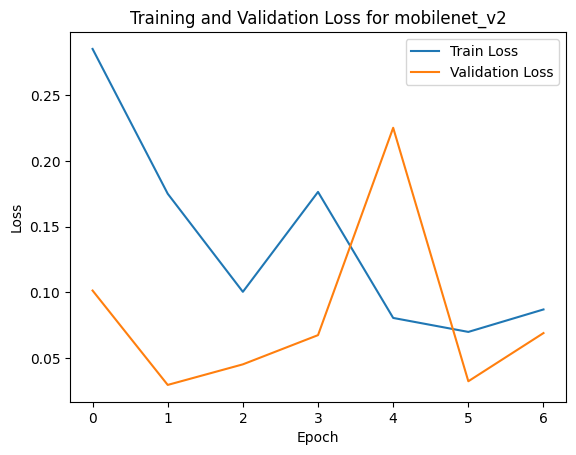

In [ ]:
# Plotting loss curves

plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title("Training and Validation Loss for mobilenet_v2")
plt.show()

# Model Evaluation and Metrics Calculation

In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Move model to evaluation mode
model.eval()

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Run inference
with torch.no_grad():  # Disable gradient calculation for faster inference
    for images, labels in test_loader:
        # Move images and labels to the same device as the model (GPU)
        images, labels = images.to('cuda'), labels.to('cuda')

        # Forward pass
        outputs = model(images)

        # Get predictions (choose the class with the highest logit score)
        _, predicted = torch.max(outputs, 1)

        # Append predictions and true labels to lists
        all_preds.extend(predicted.cpu().numpy())  # Move to CPU and convert to numpy
        all_labels.extend(labels.cpu().numpy())    # Move to CPU and convert to numpy

# Calculate evaluation metrics
accuracy = accuracy_score(all_labels, all_preds)
precision = precision_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
f1 = f1_score(all_labels, all_preds, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")


Accuracy: 97.19%
Precision: 0.9727
Recall: 0.9719
F1 Score: 0.9719


# Transfer learning using Efficientnet_b3

In [ ]:
from tqdm import tqdm  # Import tqdm for progress bars
from torch.cuda.amp import autocast, GradScaler  # Import AMP utilities

# Set number of epochs and initialize variables
num_epochs = 50  # Define the number of training epochs

model = get_transfer_model('efficientnet_b3', num_classes).to('cuda')
criterion = nn.CrossEntropyLoss()  # Loss function

optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizer with learning rate

early_stopping = EarlyStopping(patience=5)  # Initialize early stopping with patience

train_losses, val_losses = [], []  # Lists to store training and validation losses per epoch

# Initialize GradScaler for AMP
scaler = GradScaler()
# Loop over epochs
for epoch in range(num_epochs):

    print(f"Epoch {epoch+1}/{num_epochs}")
    # Training phase
    model.train()  # Set model to training mode
    train_loss = 0  # Initialize cumulative training loss for the epoch
    # Loop over training data with tqdm progress bar
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU

        optimizer.zero_grad()  # Clear previous gradients

        with autocast():  # Use AMP for mixed-precision calculations
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss

        # Scale loss to avoid underflow for float16
        scaler.scale(loss).backward()  # Backward pass with scaled loss
        scaler.step(optimizer)  # Optimizer step
        scaler.update()  # Update the scaler for next iteration
        train_loss += loss.item()  # Accumulate the training loss

    # Validation phase
    model.eval()  # Set model to evaluation mode
    val_loss = 0  # Initialize cumulative validation loss for the epoch
    with torch.no_grad():  # Disable gradient calculation for validation
        # Loop over validation data with tqdm progress bar
        for images, labels in tqdm(val_loader, desc="Validation", leave=False):
            images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU
            with autocast():  # Use AMP for mixed-precision calculations
                outputs = model(images)  # Forward pass
                loss = criterion(outputs, labels)  # Compute loss
            val_loss += loss.item()  # Accumulate the validation loss

    # Calculate average losses and append to lists
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    # Early stopping check
    if early_stopping.check_early_stop(avg_val_loss):
        print("Early stopping triggered.")
        break



# Save the model
torch.save(model.state_dict(), 'transfer_learning_efficientnet_b3.pth')
print("Model saved as 'transfer_learning_efficientnet_b3.pth'")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B3_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b3_rwightman-b3899882.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b3_rwightman-b3899882.pth
100%|██████████| 47.2M/47.2M [00:00<00:00, 161MB/s] 
/tmp/ipykernel_36/168433874.py:17: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', 

Epoch 1/50


Training:   0%|          | 0/125 [00:00<?, ?it/s]/tmp/ipykernel_36/168433874.py:31: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations
Validation:   0%|          | 0/36 [00:00<?, ?it/s]         /tmp/ipykernel_36/168433874.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations


Train Loss: 0.2881, Validation Loss: 0.1484
Epoch 2/50


Train Loss: 0.1786, Validation Loss: 0.0445
Epoch 3/50


Train Loss: 0.0959, Validation Loss: 0.0186
Epoch 4/50


Train Loss: 0.0406, Validation Loss: 0.0306
Epoch 5/50


Train Loss: 0.0280, Validation Loss: 0.0357
Epoch 6/50


Train Loss: 0.0298, Validation Loss: 0.0741
Epoch 7/50


Train Loss: 0.0693, Validation Loss: 0.0560
Epoch 8/50


Train Loss: 0.0719, Validation Loss: 0.0366
Early stopping triggered.
Model saved as 'transfer_learning_efficientnet_b3.pth'


# loss curve for efficientnet_b3

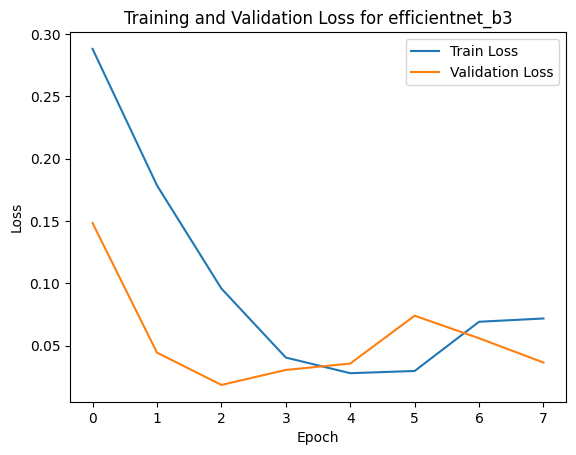

In [ ]:
# Plotting loss curves

plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title("Training and Validation Loss for efficientnet_b3")
plt.show()

# Model Evaluation and Metrics Calculation

In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Move model to evaluation mode
model.eval()

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Run inference
with torch.no_grad():  # Disable gradient calculation for faster inference
    for images, labels in test_loader:
        # Move images and labels to the same device as the model (GPU)
        images, labels = images.to('cuda'), labels.to('cuda')

        # Forward pass
        outputs = model(images)

        # Get predictions (choose the class with the highest logit score)
        _, predicted = torch.max(outputs, 1)

        # Append predictions and true labels to lists
        all_preds.extend(predicted.cpu().numpy())  # Move to CPU and convert to numpy
        all_labels.extend(labels.cpu().numpy())    # Move to CPU and convert to numpy

# Calculate evaluation metrics
accuracy = accuracy_score(all_labels, all_preds)
precision = precision_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
f1 = f1_score(all_labels, all_preds, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")


Accuracy: 98.60%
Precision: 0.9862
Recall: 0.9860
F1 Score: 0.9860


# Transfer learning using Densenet121

In [ ]:
from tqdm import tqdm  # Import tqdm for progress bars
from torch.cuda.amp import autocast, GradScaler  # Import AMP utilities

# Set number of epochs and initialize variables
num_epochs = 50  # Define the number of training epochs

model = get_transfer_model('densenet121', num_classes).to('cuda')
criterion = nn.CrossEntropyLoss()  # Loss function

optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizer with learning rate

early_stopping = EarlyStopping(patience=5)  # Initialize early stopping with patience

train_losses, val_losses = [], []  # Lists to store training and validation losses per epoch

# Initialize GradScaler for AMP
scaler = GradScaler()
# Loop over epochs
for epoch in range(num_epochs):

    print(f"Epoch {epoch+1}/{num_epochs}")
    # Training phase
    model.train()  # Set model to training mode
    train_loss = 0  # Initialize cumulative training loss for the epoch
    # Loop over training data with tqdm progress bar
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU

        optimizer.zero_grad()  # Clear previous gradients

        with autocast():  # Use AMP for mixed-precision calculations
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss

        # Scale loss to avoid underflow for float16
        scaler.scale(loss).backward()  # Backward pass with scaled loss
        scaler.step(optimizer)  # Optimizer step
        scaler.update()  # Update the scaler for next iteration
        train_loss += loss.item()  # Accumulate the training loss

    # Validation phase
    model.eval()  # Set model to evaluation mode
    val_loss = 0  # Initialize cumulative validation loss for the epoch
    with torch.no_grad():  # Disable gradient calculation for validation
        # Loop over validation data with tqdm progress bar
        for images, labels in tqdm(val_loader, desc="Validation", leave=False):
            images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU
            with autocast():  # Use AMP for mixed-precision calculations
                outputs = model(images)  # Forward pass
                loss = criterion(outputs, labels)  # Compute loss
            val_loss += loss.item()  # Accumulate the validation loss

    # Calculate average losses and append to lists
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    # Early stopping check
    if early_stopping.check_early_stop(avg_val_loss):
        print("Early stopping triggered.")
        break



# Save the model
torch.save(model.state_dict(), 'transfer_learning_densenet121.pth')
print("Model saved as 'transfer_learning_densenet121.pth'")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 172MB/s]
/tmp/ipykernel_36/473424870.py:17: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradSca

Epoch 1/50


Training:   0%|          | 0/125 [00:00<?, ?it/s]/tmp/ipykernel_36/473424870.py:31: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations
Validation:   0%|          | 0/36 [00:00<?, ?it/s]         /tmp/ipykernel_36/473424870.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations


Train Loss: 0.2164, Validation Loss: 0.0781
Epoch 2/50


Train Loss: 0.1256, Validation Loss: 0.0515
Epoch 3/50


Train Loss: 0.1130, Validation Loss: 0.0777
Epoch 4/50


Train Loss: 0.0755, Validation Loss: 0.0381
Epoch 5/50


Train Loss: 0.0862, Validation Loss: 0.0523
Epoch 6/50


Train Loss: 0.1400, Validation Loss: 0.1557
Epoch 7/50


Train Loss: 0.0738, Validation Loss: 0.1118
Epoch 8/50


Train Loss: 0.0476, Validation Loss: 0.0250
Epoch 9/50


Train Loss: 0.0260, Validation Loss: 0.0397
Epoch 10/50


Train Loss: 0.0240, Validation Loss: 0.0518
Epoch 11/50


Train Loss: 0.0661, Validation Loss: 0.0699
Epoch 12/50


Train Loss: 0.0355, Validation Loss: 0.0370
Epoch 13/50


Train Loss: 0.0296, Validation Loss: 0.0696
Early stopping triggered.
Model saved as 'transfer_learning_densenet121.pth'


# Loss curve for densenet121

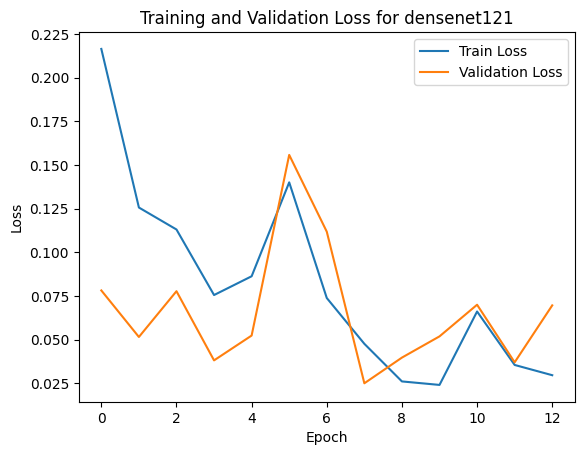

In [ ]:
# Plotting loss curves

plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title("Training and Validation Loss for densenet121")
plt.show()

# Model Evaluation and Metrics Calculation

In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Move model to evaluation mode
model.eval()

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Run inference
with torch.no_grad():  # Disable gradient calculation for faster inference
    for images, labels in test_loader:
        # Move images and labels to the same device as the model (GPU)
        images, labels = images.to('cuda'), labels.to('cuda')

        # Forward pass
        outputs = model(images)

        # Get predictions (choose the class with the highest logit score)
        _, predicted = torch.max(outputs, 1)

        # Append predictions and true labels to lists
        all_preds.extend(predicted.cpu().numpy())  # Move to CPU and convert to numpy
        all_labels.extend(labels.cpu().numpy())    # Move to CPU and convert to numpy

# Calculate evaluation metrics
accuracy = accuracy_score(all_labels, all_preds)
precision = precision_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
f1 = f1_score(all_labels, all_preds, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")


Accuracy: 97.54%
Precision: 0.9760
Recall: 0.9754
F1 Score: 0.9754


# Transfer learning using Resnet152

In [ ]:
from tqdm import tqdm  # Import tqdm for progress bars
from torch.cuda.amp import autocast, GradScaler  # Import AMP utilities

# Set number of epochs and initialize variables
num_epochs = 50  # Define the number of training epochs

model = get_transfer_model('resnet152', num_classes).to('cuda')
criterion = nn.CrossEntropyLoss()  # Loss function

optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizer with learning rate

early_stopping = EarlyStopping(patience=5)  # Initialize early stopping with patience

train_losses, val_losses = [], []  # Lists to store training and validation losses per epoch

# Initialize GradScaler for AMP
scaler = GradScaler()
# Loop over epochs
for epoch in range(num_epochs):

    print(f"Epoch {epoch+1}/{num_epochs}")
    # Training phase
    model.train()  # Set model to training mode
    train_loss = 0  # Initialize cumulative training loss for the epoch
    # Loop over training data with tqdm progress bar
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU

        optimizer.zero_grad()  # Clear previous gradients

        with autocast():  # Use AMP for mixed-precision calculations
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss

        # Scale loss to avoid underflow for float16
        scaler.scale(loss).backward()  # Backward pass with scaled loss
        scaler.step(optimizer)  # Optimizer step
        scaler.update()  # Update the scaler for next iteration
        train_loss += loss.item()  # Accumulate the training loss

    # Validation phase
    model.eval()  # Set model to evaluation mode
    val_loss = 0  # Initialize cumulative validation loss for the epoch
    with torch.no_grad():  # Disable gradient calculation for validation
        # Loop over validation data with tqdm progress bar
        for images, labels in tqdm(val_loader, desc="Validation", leave=False):
            images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU
            with autocast():  # Use AMP for mixed-precision calculations
                outputs = model(images)  # Forward pass
                loss = criterion(outputs, labels)  # Compute loss
            val_loss += loss.item()  # Accumulate the validation loss

    # Calculate average losses and append to lists
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    # Early stopping check
    if early_stopping.check_early_stop(avg_val_loss):
        print("Early stopping triggered.")
        break



# Save the model
torch.save(model.state_dict(), 'transfer_learning_resnet152.pth')
print("Model saved as 'transfer_learning_resnet152.pth'")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:01<00:00, 226MB/s] 
/tmp/ipykernel_36/2463229220.py:17: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


Epoch 1/50


Training:   0%|          | 0/125 [00:00<?, ?it/s]/tmp/ipykernel_36/2463229220.py:31: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations
Validation:   0%|          | 0/36 [00:00<?, ?it/s]         /tmp/ipykernel_36/2463229220.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations


Train Loss: 0.4257, Validation Loss: 0.0751
Epoch 2/50


Train Loss: 0.1900, Validation Loss: 0.1028
Epoch 3/50


Train Loss: 0.1041, Validation Loss: 0.0860
Epoch 4/50


Train Loss: 0.1054, Validation Loss: 0.1856
Epoch 5/50


Train Loss: 0.0599, Validation Loss: 0.1098
Epoch 6/50


Train Loss: 0.1027, Validation Loss: 0.3075
Early stopping triggered.
Model saved as 'transfer_learning_resnet152.pth'


# loss curve for resnet152

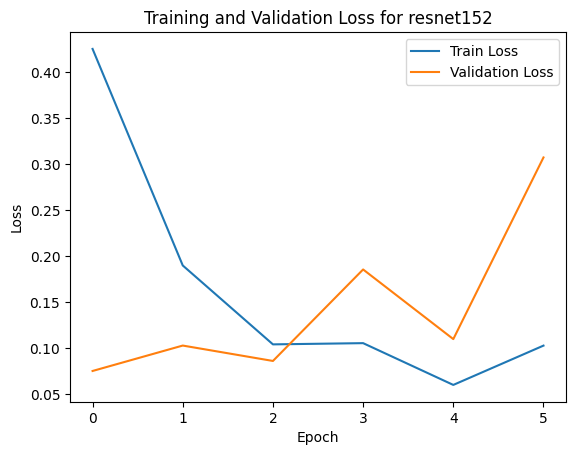

In [ ]:
# Plotting loss curves

plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title("Training and Validation Loss for resnet152")
plt.show()

# Model Evaluation and Metrics Calculation

In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Move model to evaluation mode
model.eval()

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Run inference
with torch.no_grad():  # Disable gradient calculation for faster inference
    for images, labels in test_loader:
        # Move images and labels to the same device as the model (GPU)
        images, labels = images.to('cuda'), labels.to('cuda')

        # Forward pass
        outputs = model(images)

        # Get predictions (choose the class with the highest logit score)
        _, predicted = torch.max(outputs, 1)

        # Append predictions and true labels to lists
        all_preds.extend(predicted.cpu().numpy())  # Move to CPU and convert to numpy
        all_labels.extend(labels.cpu().numpy())    # Move to CPU and convert to numpy

# Calculate evaluation metrics
accuracy = accuracy_score(all_labels, all_preds)
precision = precision_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
f1 = f1_score(all_labels, all_preds, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")


Accuracy: 95.44%
Precision: 0.9580
Recall: 0.9544
F1 Score: 0.9547


# Transfer learning using Densenet201

In [ ]:
from tqdm import tqdm  # Import tqdm for progress bars
from torch.cuda.amp import autocast, GradScaler  # Import AMP utilities

# Set number of epochs and initialize variables
num_epochs = 50  # Define the number of training epochs

model = get_transfer_model('densenet201', num_classes).to('cuda')
criterion = nn.CrossEntropyLoss()  # Loss function

optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizer with learning rate

early_stopping = EarlyStopping(patience=5)  # Initialize early stopping with patience

train_losses, val_losses = [], []  # Lists to store training and validation losses per epoch

# Initialize GradScaler for AMP
scaler = GradScaler()
# Loop over epochs
for epoch in range(num_epochs):

    print(f"Epoch {epoch+1}/{num_epochs}")
    # Training phase
    model.train()  # Set model to training mode
    train_loss = 0  # Initialize cumulative training loss for the epoch
    # Loop over training data with tqdm progress bar
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU

        optimizer.zero_grad()  # Clear previous gradients

        with autocast():  # Use AMP for mixed-precision calculations
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss

        # Scale loss to avoid underflow for float16
        scaler.scale(loss).backward()  # Backward pass with scaled loss
        scaler.step(optimizer)  # Optimizer step
        scaler.update()  # Update the scaler for next iteration
        train_loss += loss.item()  # Accumulate the training loss

    # Validation phase
    model.eval()  # Set model to evaluation mode
    val_loss = 0  # Initialize cumulative validation loss for the epoch
    with torch.no_grad():  # Disable gradient calculation for validation
        # Loop over validation data with tqdm progress bar
        for images, labels in tqdm(val_loader, desc="Validation", leave=False):
            images, labels = images.to('cuda'), labels.to('cuda')  # Move data to GPU
            with autocast():  # Use AMP for mixed-precision calculations
                outputs = model(images)  # Forward pass
                loss = criterion(outputs, labels)  # Compute loss
            val_loss += loss.item()  # Accumulate the validation loss

    # Calculate average losses and append to lists
    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    train_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    # Early stopping check
    if early_stopping.check_early_stop(avg_val_loss):
        print("Early stopping triggered.")
        break



# Save the model
torch.save(model.state_dict(), 'transfer_learning_densenet201.pth')
print("Model saved as 'transfer_learning_densenet201.pth'")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet201_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet201_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /root/.cache/torch/hub/checkpoints/densenet201-c1103571.pth
100%|██████████| 77.4M/77.4M [00:00<00:00, 181MB/s] 
/tmp/ipykernel_36/789693985.py:17: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradSc

Epoch 1/50


Training:   0%|          | 0/125 [00:00<?, ?it/s]/tmp/ipykernel_36/789693985.py:31: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations
Validation:   0%|          | 0/36 [00:00<?, ?it/s]         /tmp/ipykernel_36/789693985.py:48: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():  # Use AMP for mixed-precision calculations


Train Loss: 0.2717, Validation Loss: 0.2226
Epoch 2/50


Train Loss: 0.1616, Validation Loss: 0.2116
Epoch 3/50


Train Loss: 0.1267, Validation Loss: 0.0396
Epoch 4/50


Train Loss: 0.1001, Validation Loss: 0.0451
Epoch 5/50


Train Loss: 0.0750, Validation Loss: 0.0378
Epoch 6/50


Train Loss: 0.1068, Validation Loss: 0.0669
Epoch 7/50


Train Loss: 0.0970, Validation Loss: 0.0391
Epoch 8/50


Train Loss: 0.0602, Validation Loss: 0.0373
Epoch 9/50


Train Loss: 0.0460, Validation Loss: 0.1341
Epoch 10/50


Train Loss: 0.0287, Validation Loss: 0.0631
Epoch 11/50


Train Loss: 0.0467, Validation Loss: 0.0485
Epoch 12/50


Train Loss: 0.1224, Validation Loss: 0.2244
Epoch 13/50


Train Loss: 0.0740, Validation Loss: 0.0321
Epoch 14/50


Train Loss: 0.0233, Validation Loss: 0.0746
Epoch 15/50


Train Loss: 0.0667, Validation Loss: 0.0482
Epoch 16/50


Train Loss: 0.0663, Validation Loss: 0.0640
Epoch 17/50


Train Loss: 0.0559, Validation Loss: 0.0430
Epoch 18/50


Train Loss: 0.0441, Validation Loss: 0.0682
Early stopping triggered.
Model saved as 'transfer_learning_densenet201.pth'


# Loss curve for densenet201

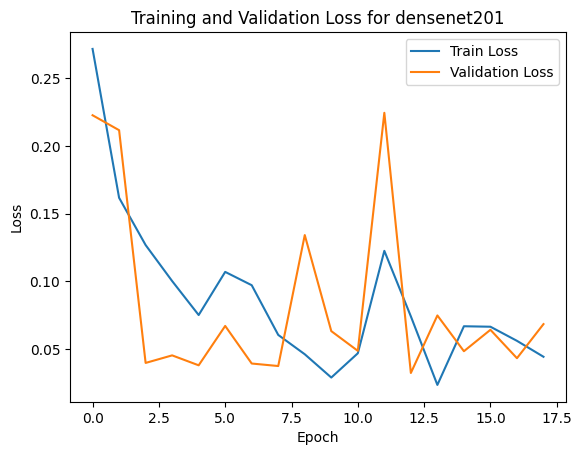

In [ ]:
# Plotting loss curves

plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title("Training and Validation Loss for densenet201")
plt.show()

# Model Evaluation and Metrics Calculation

In [ ]:
import torch
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Move model to evaluation mode
model.eval()

# Initialize lists to store predictions and true labels
all_preds = []
all_labels = []

# Run inference
with torch.no_grad():  # Disable gradient calculation for faster inference
    for images, labels in test_loader:
        # Move images and labels to the same device as the model (GPU)
        images, labels = images.to('cuda'), labels.to('cuda')

        # Forward pass
        outputs = model(images)

        # Get predictions (choose the class with the highest logit score)
        _, predicted = torch.max(outputs, 1)

        # Append predictions and true labels to lists
        all_preds.extend(predicted.cpu().numpy())  # Move to CPU and convert to numpy
        all_labels.extend(labels.cpu().numpy())    # Move to CPU and convert to numpy

# Calculate evaluation metrics
accuracy = accuracy_score(all_labels, all_preds)
precision = precision_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
f1 = f1_score(all_labels, all_preds, average='weighted')

# Print the evaluation metrics
print(f"Accuracy: {accuracy * 100:.2f}%")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")


Accuracy: 97.19%
Precision: 0.9734
Recall: 0.9719
F1 Score: 0.9720


# Model Performance Summary

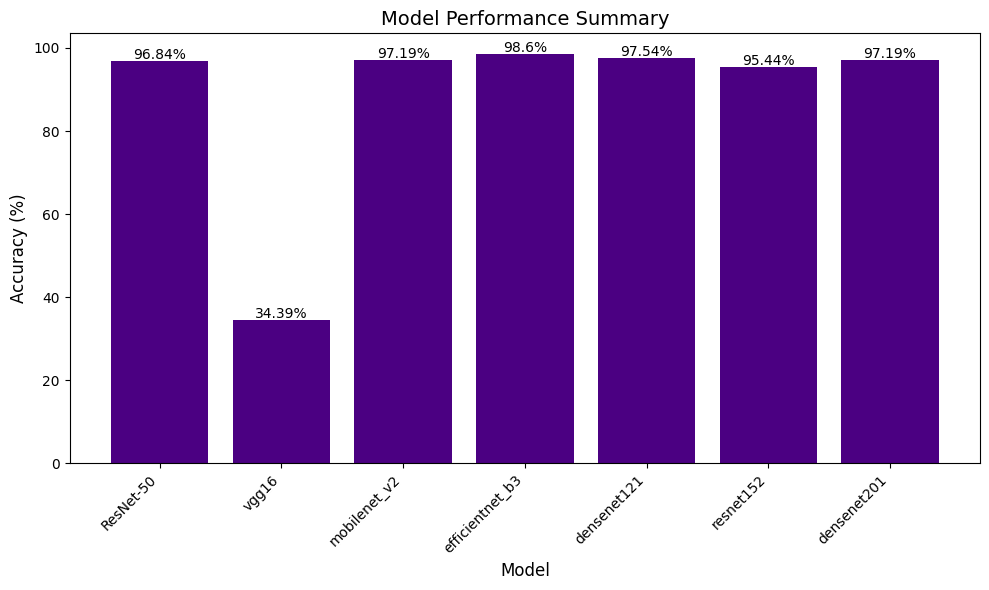

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Model names
models = ['ResNet-50', 'vgg16', 'mobilenet_v2', 'efficientnet_b3', 'densenet121', 'resnet152', 'densenet201']

# Accuracy values for each model
accuracy = [96.84,34.39, 97.19, 98.60, 97.54, 95.44, 97.19]

# Plotting the summary chart
plt.figure(figsize=(10, 6))

# Change the color here to dark purple
plt.bar(models, accuracy, color='indigo')  # Dark purple color

# Adding labels and title
plt.xlabel('Model', fontsize=12)
plt.ylabel('Accuracy (%)', fontsize=12)
plt.title('Model Performance Summary', fontsize=14)

# Displaying the accuracy values on top of bars
for i, acc in enumerate(accuracy):
    plt.text(i, acc + 0.5, f'{acc}%', ha='center', fontsize=10)

# Rotate model names on x-axis for better readability
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.tight_layout()
plt.show()


# XAI - Grad-CAM, Grad-CAM++, Eigen-CAM

# XAI - Grad-CAM, Grad-CAM++, Eigen-CAM using Resnet-50

In [ ]:
import torch
import torch.nn as nn
from torchvision import models
from pytorch_grad_cam import GradCAM, GradCAMPlusPlus, EigenCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget  # Add this import

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Load the fine-tuned ResNet-50 model
num_classes = len(class_names)
model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)  # Correct usage of the models module
model.fc = nn.Linear(model.fc.in_features, num_classes)
model.load_state_dict(torch.load("transfer_learning_resnet50.pth", weights_only=True))  # Fix the warning
model = model.to('cuda')
model.eval()

# Select a sample image from the test dataset
sample_image, _ = test_dataset[0]
sample_image = sample_image.unsqueeze(0).to('cuda')

# Convert sample image to numpy for visualization
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Set up CAM methods
target_layers = [model.layer4[-1]]
gradcam = GradCAM(model=model, target_layers=target_layers)
gradcam_plus_plus = GradCAMPlusPlus(model=model, target_layers=target_layers)
eigen_cam = EigenCAM(model=model, target_layers=target_layers)

# Run inference
with torch.no_grad():
    outputs = model(sample_image)
    predicted_class = outputs.argmax().item()
    predicted_class_name = class_names[predicted_class]

print(f"Predicted class: {predicted_class_name}")

# Generate heatmaps for each target class (excluding Healthy_Soyabean)
target_classes = [1, 2, 3]  # Indices of non-healthy classes
results = {}

for target_class in target_classes:
    target_name = class_names[target_class]
    print(f"\nGenerating CAMs for target: {target_name}")

    target = [ClassifierOutputTarget(target_class)]  # Now properly imported

    # Generate heatmaps
    gradcam_heatmap = gradcam(input_tensor=sample_image, targets=target)[0]
    gradcam_pp_heatmap = gradcam_plus_plus(input_tensor=sample_image, targets=target)[0]
    eigen_cam_heatmap = eigen_cam(input_tensor=sample_image, targets=target)[0]

    # Store results
    results[target_name] = {
        'gradcam': gradcam_heatmap,
        'gradcam_pp': gradcam_pp_heatmap,
        'eigen_cam': eigen_cam_heatmap
    }


Predicted class: Soyabean_Mosaic

Generating CAMs for target: Soyabean Semilooper_Pest_Attack

Generating CAMs for target: Soyabean_Mosaic

Generating CAMs for target: rust


# Heatmapfor XAI using resnet-50

/tmp/ipykernel_36/2161496359.py:24: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)


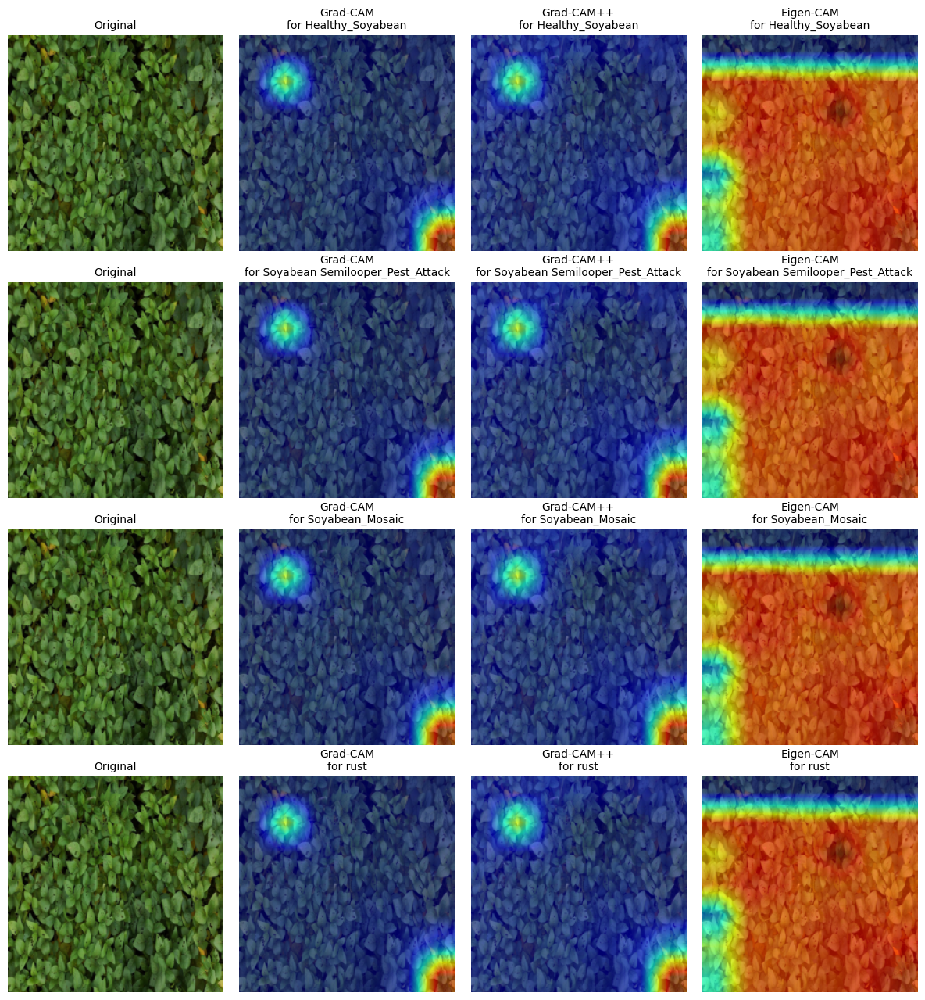

In [ ]:
import matplotlib.pyplot as plt

# Assuming `class_names` is defined elsewhere
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Example target_heatmaps dictionary
target_heatmaps = {
    'gradcam': gradcam_heatmap,
    'gradcam_pp': gradcam_pp_heatmap,
    'eigen_cam': eigen_cam_heatmap
}

# Assuming `original_image_np` is the unnormalized image
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Create the plot
fig, ax = plt.subplots(figsize=(12, len(class_names) * 4))

row = 1
for class_name in class_names:
    # Original image for reference
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)
    plt.imshow(original_image_np)
    plt.title(f"Original", fontsize=10)
    plt.axis("off")

    # Grad-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 2)
    gradcam_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam'], use_rgb=True)
    plt.imshow(gradcam_result)
    plt.title(f"Grad-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Grad-CAM++
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 3)
    gradcam_pp_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam_pp'], use_rgb=True)
    plt.imshow(gradcam_pp_result)
    plt.title(f"Grad-CAM++\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Eigen-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 4)
    eigen_cam_result = show_cam_on_image(original_image_np, target_heatmaps['eigen_cam'], use_rgb=True)
    plt.imshow(eigen_cam_result)
    plt.title(f"Eigen-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    row += 1

# Adjust layout and save the plot
plt.tight_layout()
plt.savefig("soybean_class_activation_maps.png", dpi=300, bbox_inches='tight')
plt.show()


# XAI - Grad-CAM, Grad-CAM++, Eigen-CAM using vgg16

In [ ]:
import torch
import torch.nn as nn
from torchvision import models
from pytorch_grad_cam import GradCAM, GradCAMPlusPlus, EigenCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget  # Add this import

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Load the fine-tuned VGG16 model
num_classes = len(class_names)
model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1)  # Correct usage of the models module
model.classifier[6] = nn.Linear(model.classifier[6].in_features, num_classes)  # Adjust the final layer
model.load_state_dict(torch.load("transfer_learning_vgg16.pth", weights_only=True))  # Fix the warning
model = model.to('cuda')
model.eval()

# Select a sample image from the test dataset
sample_image, _ = test_dataset[0]
sample_image = sample_image.unsqueeze(0).to('cuda')

# Convert sample image to numpy for visualization
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Set up CAM methods
target_layers = [model.features[-1]]  # Targeting the last convolutional layer
gradcam = GradCAM(model=model, target_layers=target_layers)
gradcam_plus_plus = GradCAMPlusPlus(model=model, target_layers=target_layers)
eigen_cam = EigenCAM(model=model, target_layers=target_layers)

# Run inference
with torch.no_grad():
    outputs = model(sample_image)
    predicted_class = outputs.argmax().item()
    predicted_class_name = class_names[predicted_class]

print(f"Predicted class: {predicted_class_name}")

# Generate heatmaps for each target class (excluding Healthy_Soyabean)
target_classes = [1, 2, 3]  # Indices of non-healthy classes
results = {}

for target_class in target_classes:
    target_name = class_names[target_class]
    print(f"\nGenerating CAMs for target: {target_name}")

    target = [ClassifierOutputTarget(target_class)]  # Now properly imported

    # Generate heatmaps
    gradcam_heatmap = gradcam(input_tensor=sample_image, targets=target)[0]
    gradcam_pp_heatmap = gradcam_plus_plus(input_tensor=sample_image, targets=target)[0]
    eigen_cam_heatmap = eigen_cam(input_tensor=sample_image, targets=target)[0]

    # Store results
    results[target_name] = {
        'gradcam': gradcam_heatmap,
        'gradcam_pp': gradcam_pp_heatmap,
        'eigen_cam': eigen_cam_heatmap
    }


Predicted class: rust

Generating CAMs for target: Soyabean Semilooper_Pest_Attack

Generating CAMs for target: Soyabean_Mosaic

Generating CAMs for target: rust


# Heatmap for XAI using vgg16

/tmp/ipykernel_36/2161496359.py:24: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)


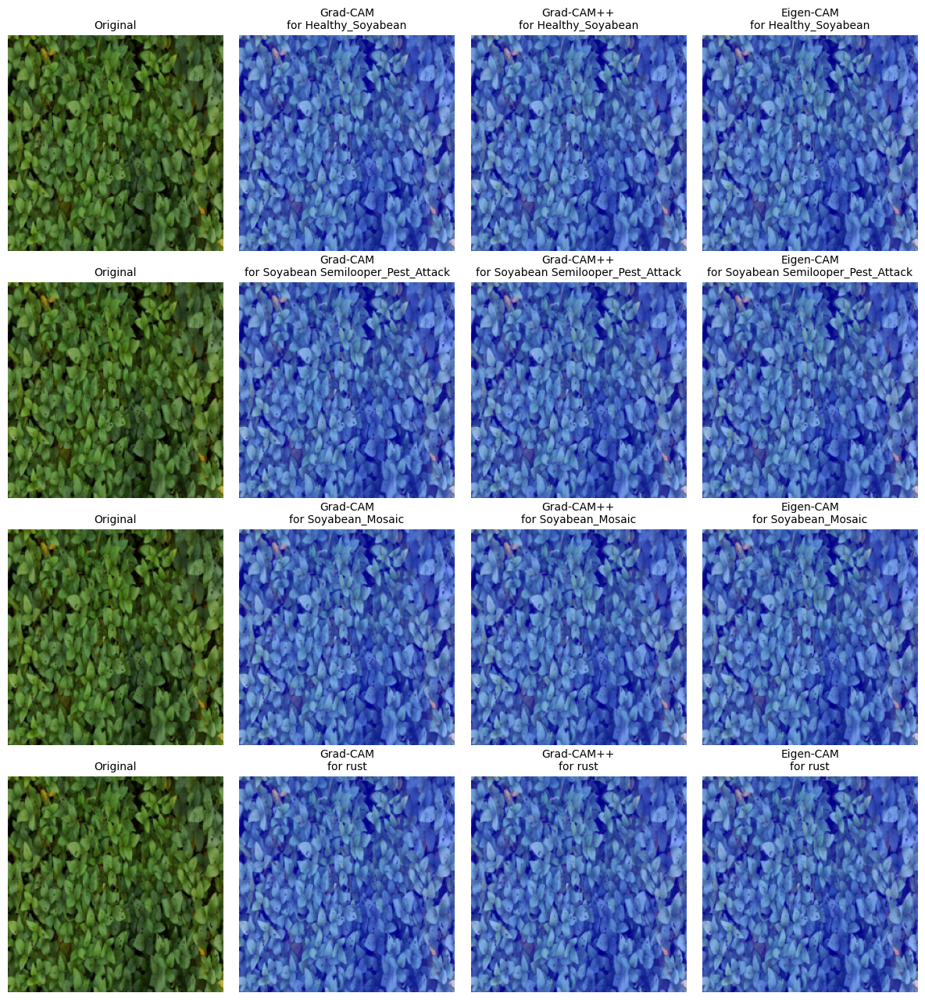

In [ ]:
import matplotlib.pyplot as plt

# Assuming `class_names` is defined elsewhere
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Example target_heatmaps dictionary
target_heatmaps = {
    'gradcam': gradcam_heatmap,
    'gradcam_pp': gradcam_pp_heatmap,
    'eigen_cam': eigen_cam_heatmap
}

# Assuming `original_image_np` is the unnormalized image
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Create the plot
fig, ax = plt.subplots(figsize=(12, len(class_names) * 4))

row = 1
for class_name in class_names:
    # Original image for reference
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)
    plt.imshow(original_image_np)
    plt.title(f"Original", fontsize=10)
    plt.axis("off")

    # Grad-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 2)
    gradcam_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam'], use_rgb=True)
    plt.imshow(gradcam_result)
    plt.title(f"Grad-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Grad-CAM++
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 3)
    gradcam_pp_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam_pp'], use_rgb=True)
    plt.imshow(gradcam_pp_result)
    plt.title(f"Grad-CAM++\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Eigen-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 4)
    eigen_cam_result = show_cam_on_image(original_image_np, target_heatmaps['eigen_cam'], use_rgb=True)
    plt.imshow(eigen_cam_result)
    plt.title(f"Eigen-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    row += 1

# Adjust layout and save the plot
plt.tight_layout()
plt.savefig("soybean_class_activation_maps.png", dpi=300, bbox_inches='tight')
plt.show()


# XAI - Grad-CAM, Grad-CAM++, Eigen-CAM using Mobilenet_v2



In [ ]:
import torch
import torch.nn as nn
from torchvision import models
from pytorch_grad_cam import GradCAM, GradCAMPlusPlus, EigenCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Load the fine-tuned MobileNetV2 model
num_classes = len(class_names)
model = models.mobilenet_v2(weights=models.MobileNet_V2_Weights.IMAGENET1K_V1)  # MobileNetV2
model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)  # Adjust the final layer
model.load_state_dict(torch.load("transfer_learning_mobilenet_v2.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the test dataset
sample_image, _ = test_dataset[0]
sample_image = sample_image.unsqueeze(0).to('cuda')

# Convert sample image to numpy for visualization
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Set up CAM methods
target_layers = [model.features[-1]]  # Targeting the last convolutional layer
gradcam = GradCAM(model=model, target_layers=target_layers)
gradcam_plus_plus = GradCAMPlusPlus(model=model, target_layers=target_layers)
eigen_cam = EigenCAM(model=model, target_layers=target_layers)

# Run inference
with torch.no_grad():
    outputs = model(sample_image)
    predicted_class = outputs.argmax().item()
    predicted_class_name = class_names[predicted_class]

print(f"Predicted class: {predicted_class_name}")

# Generate heatmaps for each target class (excluding Healthy_Soyabean)
target_classes = [1, 2, 3]  # Indices of non-healthy classes
results = {}

for target_class in target_classes:
    target_name = class_names[target_class]
    print(f"\nGenerating CAMs for target: {target_name}")

    target = [ClassifierOutputTarget(target_class)]  # Now properly imported

    # Generate heatmaps
    gradcam_heatmap = gradcam(input_tensor=sample_image, targets=target)[0]
    gradcam_pp_heatmap = gradcam_plus_plus(input_tensor=sample_image, targets=target)[0]
    eigen_cam_heatmap = eigen_cam(input_tensor=sample_image, targets=target)[0]

    # Store results
    results[target_name] = {
        'gradcam': gradcam_heatmap,
        'gradcam_pp': gradcam_pp_heatmap,
        'eigen_cam': eigen_cam_heatmap
    }


Predicted class: Soyabean_Mosaic

Generating CAMs for target: Soyabean Semilooper_Pest_Attack

Generating CAMs for target: Soyabean_Mosaic

Generating CAMs for target: rust


# Heatmap for XAI using mobilenet_v2

/tmp/ipykernel_36/2161496359.py:24: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)


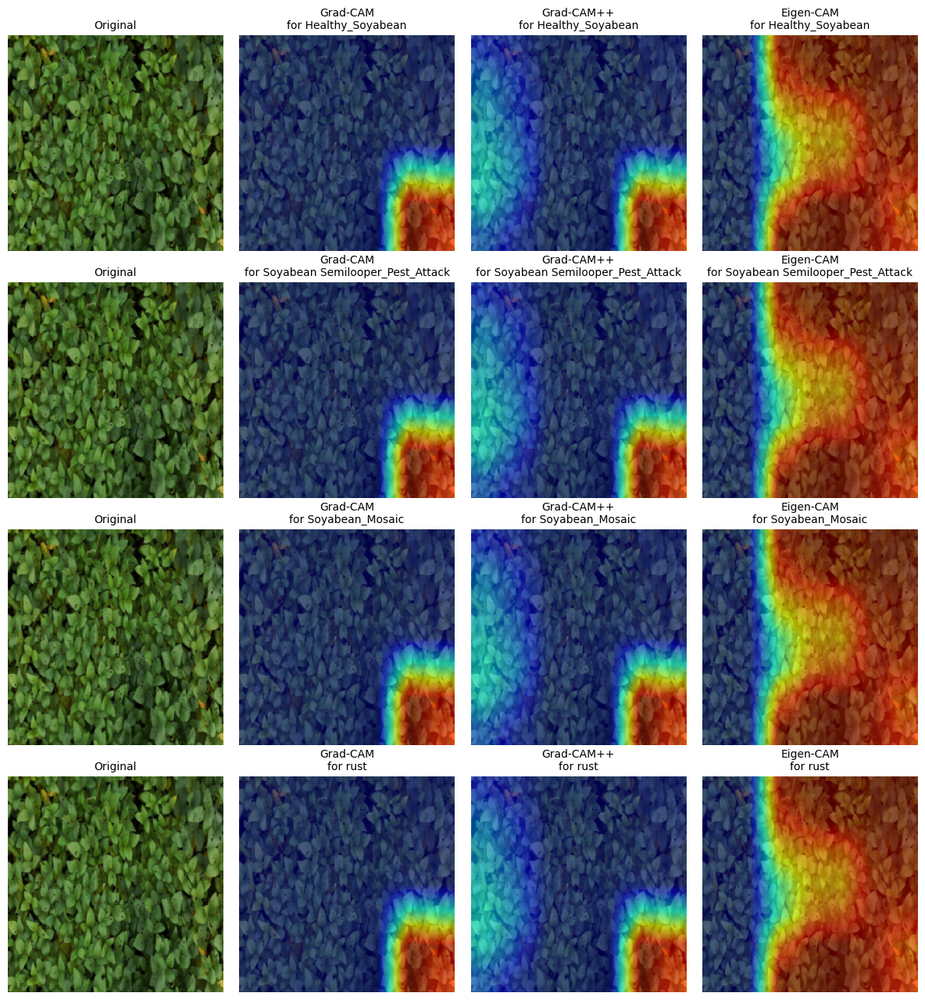

In [ ]:
import matplotlib.pyplot as plt

# Assuming `class_names` is defined elsewhere
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Example target_heatmaps dictionary
target_heatmaps = {
    'gradcam': gradcam_heatmap,
    'gradcam_pp': gradcam_pp_heatmap,
    'eigen_cam': eigen_cam_heatmap
}

# Assuming `original_image_np` is the unnormalized image
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Create the plot
fig, ax = plt.subplots(figsize=(12, len(class_names) * 4))

row = 1
for class_name in class_names:
    # Original image for reference
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)
    plt.imshow(original_image_np)
    plt.title(f"Original", fontsize=10)
    plt.axis("off")

    # Grad-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 2)
    gradcam_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam'], use_rgb=True)
    plt.imshow(gradcam_result)
    plt.title(f"Grad-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Grad-CAM++
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 3)
    gradcam_pp_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam_pp'], use_rgb=True)
    plt.imshow(gradcam_pp_result)
    plt.title(f"Grad-CAM++\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Eigen-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 4)
    eigen_cam_result = show_cam_on_image(original_image_np, target_heatmaps['eigen_cam'], use_rgb=True)
    plt.imshow(eigen_cam_result)
    plt.title(f"Eigen-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    row += 1

# Adjust layout and save the plot
plt.tight_layout()
plt.savefig("soybean_class_activation_maps.png", dpi=300, bbox_inches='tight')
plt.show()


# XAI - Grad-CAM, Grad-CAM++, Eigen-CAM using EfficientNet_B3

In [ ]:
import torch
import torch.nn as nn
from torchvision import models
from pytorch_grad_cam import GradCAM, GradCAMPlusPlus, EigenCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget  # Add this import
import numpy as np

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Load the fine-tuned EfficientNetB3 model
num_classes = len(class_names)
model = models.efficientnet_b3(weights=models.EfficientNet_B3_Weights.IMAGENET1K_V1)  # EfficientNetB3
model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)  # Adjust the final layer
model.load_state_dict(torch.load("transfer_learning_efficientnet_b3.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the test dataset
sample_image, _ = test_dataset[0]  # Assuming `test_dataset` is defined
sample_image = sample_image.unsqueeze(0).to('cuda')  # Add batch dimension and move to GPU

# Convert sample image to numpy for visualization
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Set up CAM methods
target_layers = [model.features[-1]]  # Targeting the last convolutional layer
gradcam = GradCAM(model=model, target_layers=target_layers)
gradcam_plus_plus = GradCAMPlusPlus(model=model, target_layers=target_layers)
eigen_cam = EigenCAM(model=model, target_layers=target_layers)

# Run inference
with torch.no_grad():
    outputs = model(sample_image)
    predicted_class = outputs.argmax().item()
    predicted_class_name = class_names[predicted_class]

print(f"Predicted class: {predicted_class_name}")

# Generate heatmaps for each target class (excluding Healthy_Soyabean)
target_classes = [1, 2, 3]  # Indices of non-healthy classes
results = {}

for target_class in target_classes:
    target_name = class_names[target_class]
    print(f"\nGenerating CAMs for target: {target_name}")

    target = [ClassifierOutputTarget(target_class)]  # Now properly imported

    # Generate heatmaps
    gradcam_heatmap = gradcam(input_tensor=sample_image, targets=target)[0]
    gradcam_pp_heatmap = gradcam_plus_plus(input_tensor=sample_image, targets=target)[0]
    eigen_cam_heatmap = eigen_cam(input_tensor=sample_image, targets=target)[0]

    # Store results
    results[target_name] = {
        'gradcam': gradcam_heatmap,
        'gradcam_pp': gradcam_pp_heatmap,
        'eigen_cam': eigen_cam_heatmap
    }

Predicted class: Soyabean_Mosaic

Generating CAMs for target: Soyabean Semilooper_Pest_Attack

Generating CAMs for target: Soyabean_Mosaic

Generating CAMs for target: rust


# Heatmap for XAI using EfficientNet_B3

/tmp/ipykernel_36/2161496359.py:24: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)


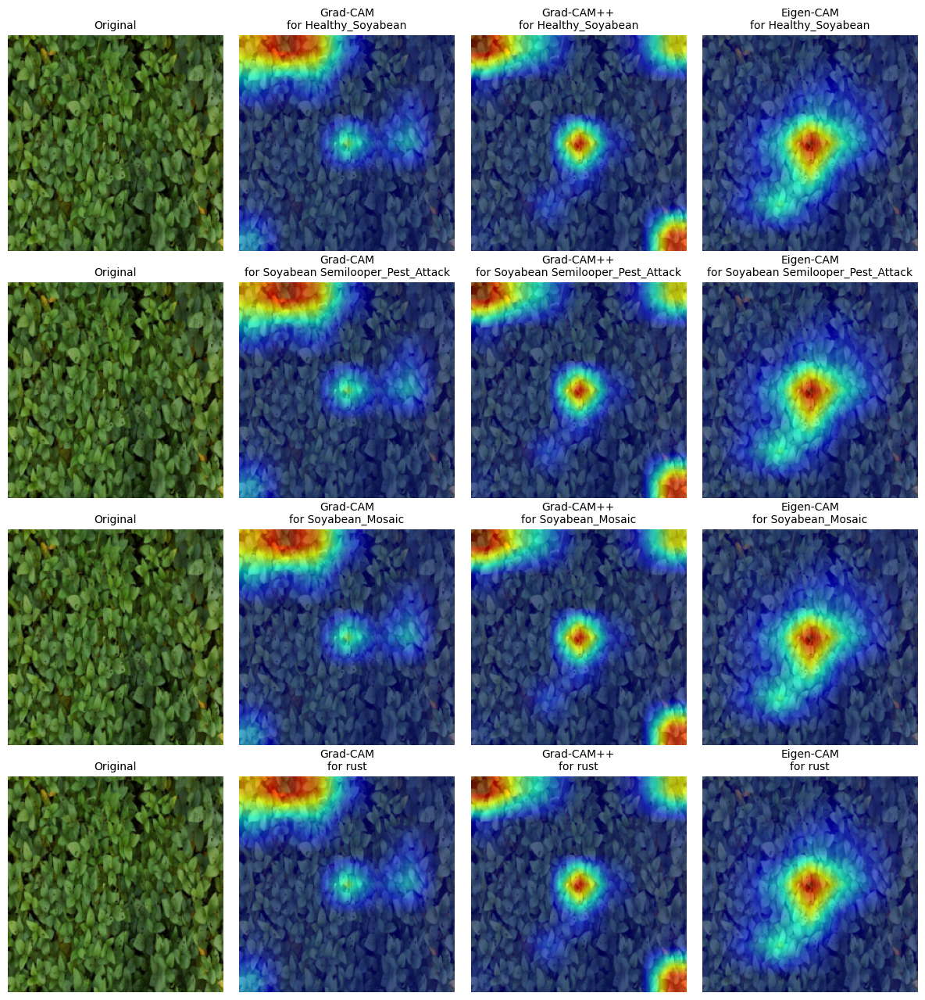

In [ ]:
import matplotlib.pyplot as plt

# Assuming `class_names` is defined elsewhere
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Example target_heatmaps dictionary
target_heatmaps = {
    'gradcam': gradcam_heatmap,
    'gradcam_pp': gradcam_pp_heatmap,
    'eigen_cam': eigen_cam_heatmap
}

# Assuming `original_image_np` is the unnormalized image
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Create the plot
fig, ax = plt.subplots(figsize=(12, len(class_names) * 4))

row = 1
for class_name in class_names:
    # Original image for reference
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)
    plt.imshow(original_image_np)
    plt.title(f"Original", fontsize=10)
    plt.axis("off")

    # Grad-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 2)
    gradcam_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam'], use_rgb=True)
    plt.imshow(gradcam_result)
    plt.title(f"Grad-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Grad-CAM++
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 3)
    gradcam_pp_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam_pp'], use_rgb=True)
    plt.imshow(gradcam_pp_result)
    plt.title(f"Grad-CAM++\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Eigen-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 4)
    eigen_cam_result = show_cam_on_image(original_image_np, target_heatmaps['eigen_cam'], use_rgb=True)
    plt.imshow(eigen_cam_result)
    plt.title(f"Eigen-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    row += 1

# Adjust layout and save the plot
plt.tight_layout()
plt.savefig("soybean_class_activation_maps.png", dpi=300, bbox_inches='tight')
plt.show()


# XAI - Grad-CAM, Grad-CAM++, Eigen-CAM using densenet121

In [ ]:
import torch
import torch.nn as nn
from torchvision import models
from pytorch_grad_cam import GradCAM, GradCAMPlusPlus, EigenCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget  # Add this import
import numpy as np

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Load the fine-tuned DenseNet121 model
num_classes = len(class_names)
model = models.densenet121(weights=models.DenseNet121_Weights.IMAGENET1K_V1)  # DenseNet121
model.classifier = nn.Linear(model.classifier.in_features, num_classes)  # Adjust the final layer
model.load_state_dict(torch.load("transfer_learning_densenet121.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the test dataset
sample_image, _ = test_dataset[0]  # Assuming `test_dataset` is defined
sample_image = sample_image.unsqueeze(0).to('cuda')  # Add batch dimension and move to GPU

# Convert sample image to numpy for visualization
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Set up CAM methods
target_layers = [model.features[-1]]  # Targeting the last convolutional layer
gradcam = GradCAM(model=model, target_layers=target_layers)
gradcam_plus_plus = GradCAMPlusPlus(model=model, target_layers=target_layers)
eigen_cam = EigenCAM(model=model, target_layers=target_layers)

# Run inference
with torch.no_grad():
    outputs = model(sample_image)
    predicted_class = outputs.argmax().item()
    predicted_class_name = class_names[predicted_class]

print(f"Predicted class: {predicted_class_name}")

# Generate heatmaps for each target class (excluding Healthy_Soyabean)
target_classes = [1, 2, 3]  # Indices of non-healthy classes
results = {}

for target_class in target_classes:
    target_name = class_names[target_class]
    print(f"\nGenerating CAMs for target: {target_name}")

    target = [ClassifierOutputTarget(target_class)]  # Now properly imported

    # Generate heatmaps
    gradcam_heatmap = gradcam(input_tensor=sample_image, targets=target)[0]
    gradcam_pp_heatmap = gradcam_plus_plus(input_tensor=sample_image, targets=target)[0]
    eigen_cam_heatmap = eigen_cam(input_tensor=sample_image, targets=target)[0]

    # Store results
    results[target_name] = {
        'gradcam': gradcam_heatmap,
        'gradcam_pp': gradcam_pp_heatmap,
        'eigen_cam': eigen_cam_heatmap
    }

Predicted class: Soyabean_Mosaic

Generating CAMs for target: Soyabean Semilooper_Pest_Attack

Generating CAMs for target: Soyabean_Mosaic

Generating CAMs for target: rust


# Heatmap for XAI using densenet121

/tmp/ipykernel_36/2161496359.py:24: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)


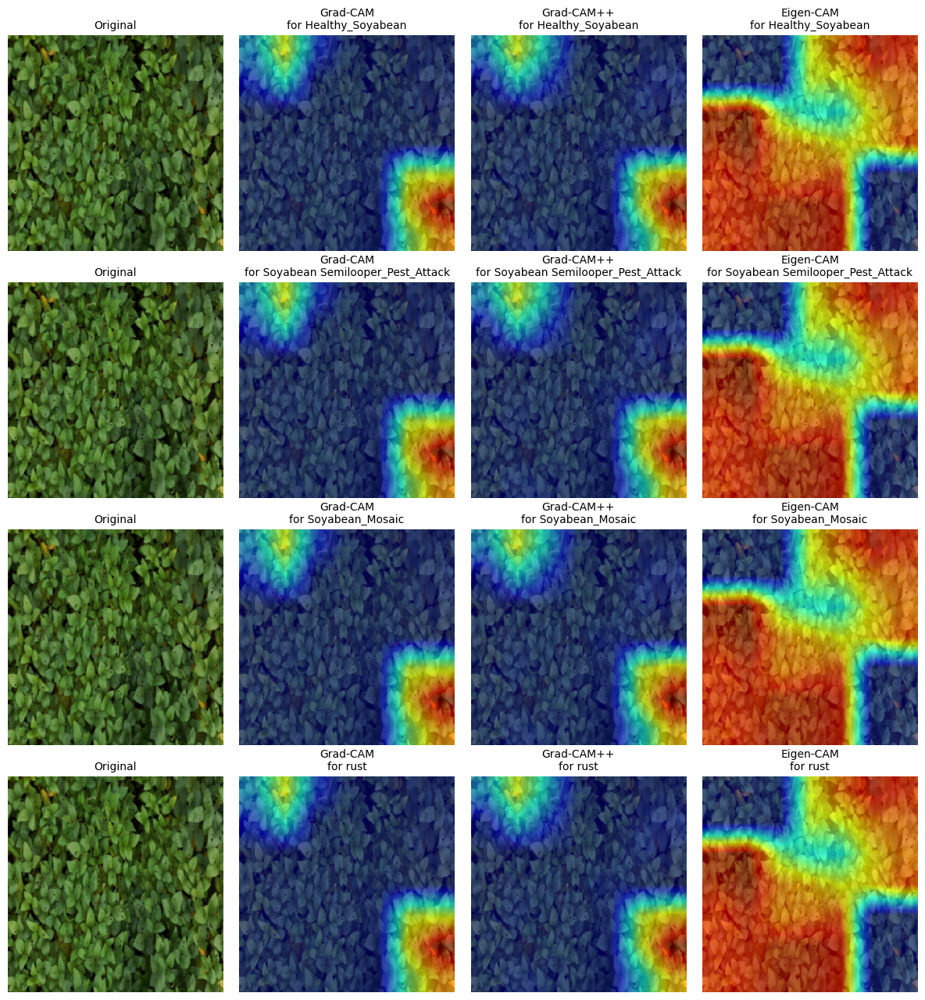

In [ ]:
import matplotlib.pyplot as plt

# Assuming `class_names` is defined elsewhere
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Example target_heatmaps dictionary
target_heatmaps = {
    'gradcam': gradcam_heatmap,
    'gradcam_pp': gradcam_pp_heatmap,
    'eigen_cam': eigen_cam_heatmap
}

# Assuming `original_image_np` is the unnormalized image
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Create the plot
fig, ax = plt.subplots(figsize=(12, len(class_names) * 4))

row = 1
for class_name in class_names:
    # Original image for reference
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)
    plt.imshow(original_image_np)
    plt.title(f"Original", fontsize=10)
    plt.axis("off")

    # Grad-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 2)
    gradcam_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam'], use_rgb=True)
    plt.imshow(gradcam_result)
    plt.title(f"Grad-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Grad-CAM++
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 3)
    gradcam_pp_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam_pp'], use_rgb=True)
    plt.imshow(gradcam_pp_result)
    plt.title(f"Grad-CAM++\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Eigen-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 4)
    eigen_cam_result = show_cam_on_image(original_image_np, target_heatmaps['eigen_cam'], use_rgb=True)
    plt.imshow(eigen_cam_result)
    plt.title(f"Eigen-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    row += 1

# Adjust layout and save the plot
plt.tight_layout()
plt.savefig("soybean_class_activation_maps.png", dpi=300, bbox_inches='tight')
plt.show()


# XAI - Grad-CAM, Grad-CAM++, Eigen-CAM using resnet152

In [ ]:
import torch
import torch.nn as nn
from torchvision import models
from pytorch_grad_cam import GradCAM, GradCAMPlusPlus, EigenCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget  # Add this import
import numpy as np

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Load the fine-tuned ResNet152 model
num_classes = len(class_names)
model = models.resnet152(weights=models.ResNet152_Weights.IMAGENET1K_V1)  # ResNet152
model.fc = nn.Linear(model.fc.in_features, num_classes)  # Adjust the final layer to match number of classes
model.load_state_dict(torch.load("transfer_learning_resnet152.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the test dataset
sample_image, _ = test_dataset[0]  # Assuming `test_dataset` is defined
sample_image = sample_image.unsqueeze(0).to('cuda')  # Add batch dimension and move to GPU

# Convert sample image to numpy for visualization
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Set up CAM methods
target_layers = [model.layer4[-1]]  # Targeting the last convolutional layer (layer4)
gradcam = GradCAM(model=model, target_layers=target_layers)
gradcam_plus_plus = GradCAMPlusPlus(model=model, target_layers=target_layers)
eigen_cam = EigenCAM(model=model, target_layers=target_layers)

# Run inference
with torch.no_grad():
    outputs = model(sample_image)
    predicted_class = outputs.argmax().item()
    predicted_class_name = class_names[predicted_class]

print(f"Predicted class: {predicted_class_name}")

# Generate heatmaps for each target class (excluding Healthy_Soyabean)
target_classes = [1, 2, 3]  # Indices of non-healthy classes
results = {}

for target_class in target_classes:
    target_name = class_names[target_class]
    print(f"\nGenerating CAMs for target: {target_name}")

    target = [ClassifierOutputTarget(target_class)]  # Now properly imported

    # Generate heatmaps
    gradcam_heatmap = gradcam(input_tensor=sample_image, targets=target)[0]
    gradcam_pp_heatmap = gradcam_plus_plus(input_tensor=sample_image, targets=target)[0]
    eigen_cam_heatmap = eigen_cam(input_tensor=sample_image, targets=target)[0]

    # Store results
    results[target_name] = {
        'gradcam': gradcam_heatmap,
        'gradcam_pp': gradcam_pp_heatmap,
        'eigen_cam': eigen_cam_heatmap
    }

Predicted class: Soyabean_Mosaic

Generating CAMs for target: Soyabean Semilooper_Pest_Attack

Generating CAMs for target: Soyabean_Mosaic

Generating CAMs for target: rust


# Heatmap for XAI using resnet152

/tmp/ipykernel_36/2161496359.py:24: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)


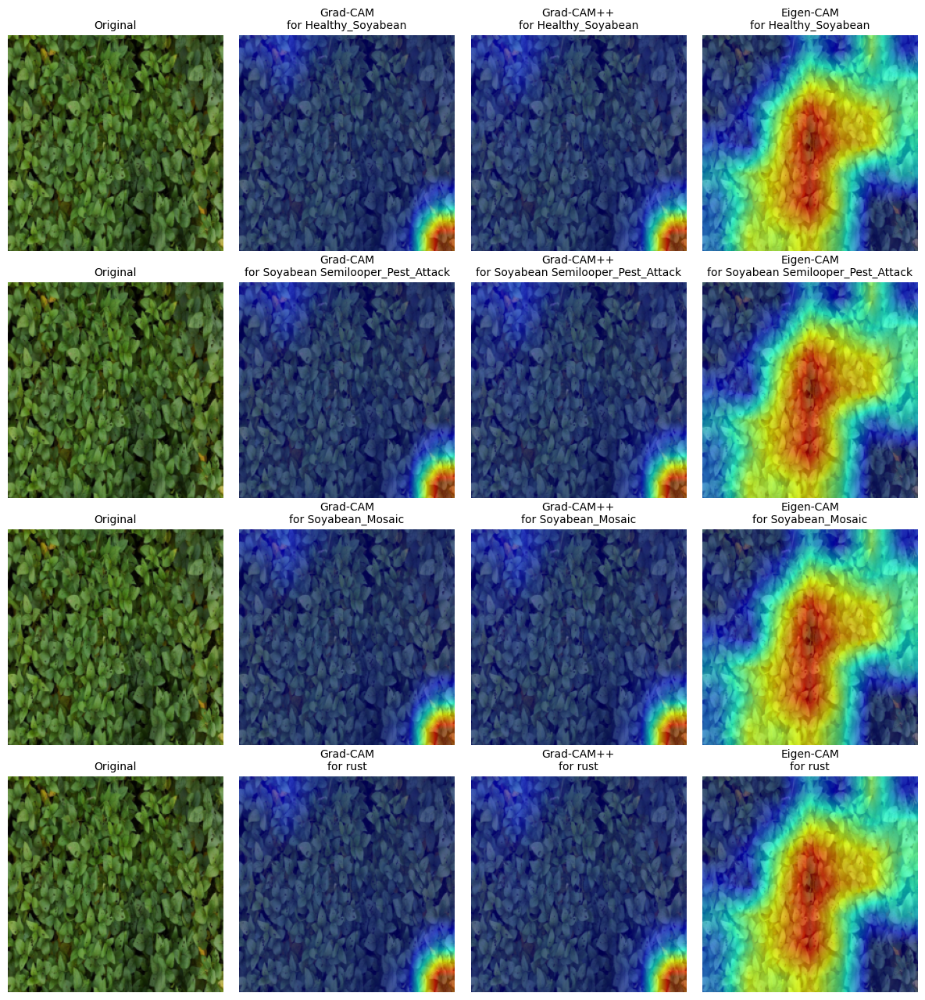

In [ ]:
import matplotlib.pyplot as plt

# Assuming `class_names` is defined elsewhere
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Example target_heatmaps dictionary
target_heatmaps = {
    'gradcam': gradcam_heatmap,
    'gradcam_pp': gradcam_pp_heatmap,
    'eigen_cam': eigen_cam_heatmap
}

# Assuming `original_image_np` is the unnormalized image
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Create the plot
fig, ax = plt.subplots(figsize=(12, len(class_names) * 4))

row = 1
for class_name in class_names:
    # Original image for reference
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)
    plt.imshow(original_image_np)
    plt.title(f"Original", fontsize=10)
    plt.axis("off")

    # Grad-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 2)
    gradcam_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam'], use_rgb=True)
    plt.imshow(gradcam_result)
    plt.title(f"Grad-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Grad-CAM++
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 3)
    gradcam_pp_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam_pp'], use_rgb=True)
    plt.imshow(gradcam_pp_result)
    plt.title(f"Grad-CAM++\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Eigen-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 4)
    eigen_cam_result = show_cam_on_image(original_image_np, target_heatmaps['eigen_cam'], use_rgb=True)
    plt.imshow(eigen_cam_result)
    plt.title(f"Eigen-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    row += 1

# Adjust layout and save the plot
plt.tight_layout()
plt.savefig("soybean_class_activation_maps.png", dpi=300, bbox_inches='tight')
plt.show()


# XAI - Grad-CAM, Grad-CAM++, Eigen-CAM using densenet201

In [ ]:
import torch
import torch.nn as nn
from torchvision import models
from pytorch_grad_cam import GradCAM, GradCAMPlusPlus, EigenCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget  # Add this import
import numpy as np

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Load the fine-tuned DenseNet201 model
num_classes = len(class_names)
model = models.densenet201(weights=models.DenseNet201_Weights.IMAGENET1K_V1)  # DenseNet201
model.classifier = nn.Linear(model.classifier.in_features, num_classes)  # Adjust the final layer to match the number of classes
model.load_state_dict(torch.load("transfer_learning_densenet201.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the test dataset
sample_image, _ = test_dataset[0]  # Assuming `test_dataset` is defined
sample_image = sample_image.unsqueeze(0).to('cuda')  # Add batch dimension and move to GPU

# Convert sample image to numpy for visualization
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Set up CAM methods
target_layers = [model.features[-1]]  # Targeting the last convolutional layer (features)
gradcam = GradCAM(model=model, target_layers=target_layers)
gradcam_plus_plus = GradCAMPlusPlus(model=model, target_layers=target_layers)
eigen_cam = EigenCAM(model=model, target_layers=target_layers)

# Run inference
with torch.no_grad():
    outputs = model(sample_image)
    predicted_class = outputs.argmax().item()
    predicted_class_name = class_names[predicted_class]

print(f"Predicted class: {predicted_class_name}")

# Generate heatmaps for each target class (excluding Healthy_Soyabean)
target_classes = [1, 2, 3]  # Indices of non-healthy classes
results = {}

for target_class in target_classes:
    target_name = class_names[target_class]
    print(f"\nGenerating CAMs for target: {target_name}")

    target = [ClassifierOutputTarget(target_class)]  # Now properly imported

    # Generate heatmaps
    gradcam_heatmap = gradcam(input_tensor=sample_image, targets=target)[0]
    gradcam_pp_heatmap = gradcam_plus_plus(input_tensor=sample_image, targets=target)[0]
    eigen_cam_heatmap = eigen_cam(input_tensor=sample_image, targets=target)[0]

    # Store results
    results[target_name] = {
        'gradcam': gradcam_heatmap,
        'gradcam_pp': gradcam_pp_heatmap,
        'eigen_cam': eigen_cam_heatmap
    }

Predicted class: Soyabean_Mosaic

Generating CAMs for target: Soyabean Semilooper_Pest_Attack

Generating CAMs for target: Soyabean_Mosaic

Generating CAMs for target: rust


# Heatmap for XAI using densenet201

/tmp/ipykernel_36/2161496359.py:24: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)


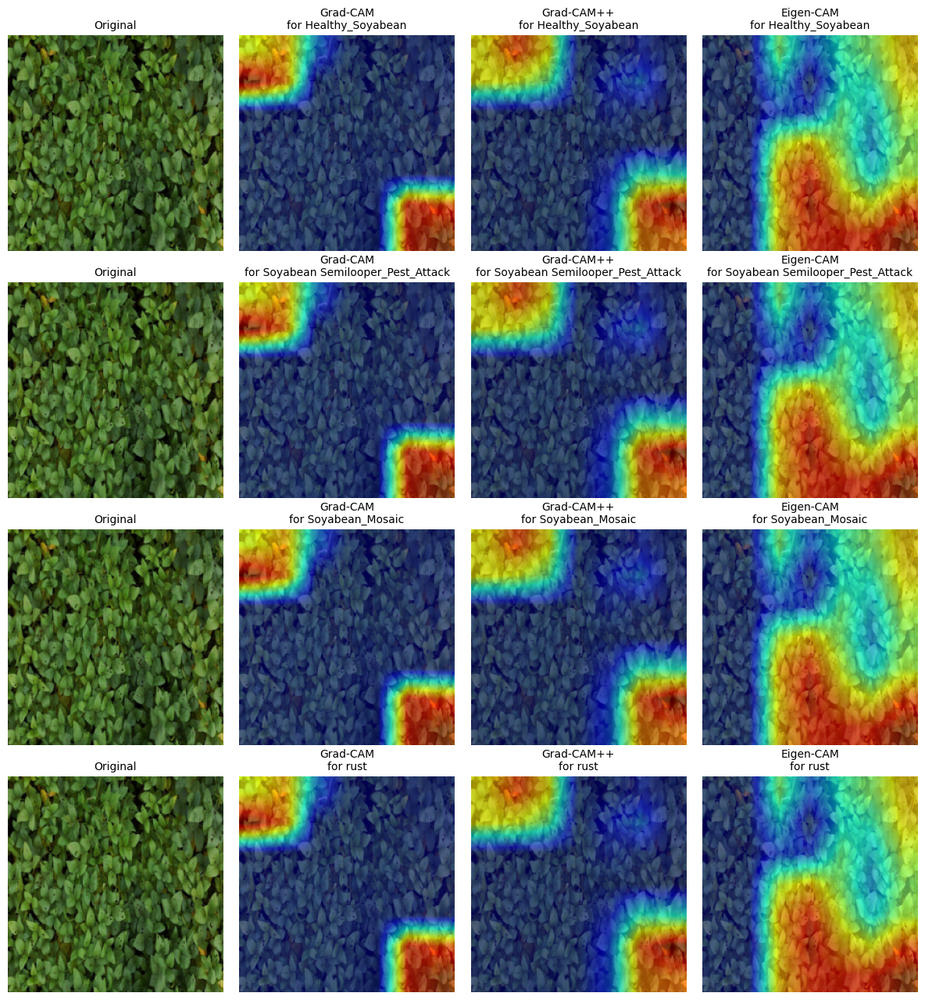

In [ ]:
import matplotlib.pyplot as plt

# Assuming `class_names` is defined elsewhere
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Example target_heatmaps dictionary
target_heatmaps = {
    'gradcam': gradcam_heatmap,
    'gradcam_pp': gradcam_pp_heatmap,
    'eigen_cam': eigen_cam_heatmap
}

# Assuming `original_image_np` is the unnormalized image
original_image_np = sample_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)

# Create the plot
fig, ax = plt.subplots(figsize=(12, len(class_names) * 4))

row = 1
for class_name in class_names:
    # Original image for reference
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 1)
    plt.imshow(original_image_np)
    plt.title(f"Original", fontsize=10)
    plt.axis("off")

    # Grad-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 2)
    gradcam_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam'], use_rgb=True)
    plt.imshow(gradcam_result)
    plt.title(f"Grad-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Grad-CAM++
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 3)
    gradcam_pp_result = show_cam_on_image(original_image_np, target_heatmaps['gradcam_pp'], use_rgb=True)
    plt.imshow(gradcam_pp_result)
    plt.title(f"Grad-CAM++\nfor {class_name}", fontsize=10)
    plt.axis("off")

    # Eigen-CAM
    plt.subplot(len(class_names) + 1, 4, (row - 1) * 4 + 4)
    eigen_cam_result = show_cam_on_image(original_image_np, target_heatmaps['eigen_cam'], use_rgb=True)
    plt.imshow(eigen_cam_result)
    plt.title(f"Eigen-CAM\nfor {class_name}", fontsize=10)
    plt.axis("off")

    row += 1

# Adjust layout and save the plot
plt.tight_layout()
plt.savefig("soybean_class_activation_maps.png", dpi=300, bbox_inches='tight')
plt.show()


# Lime using Resnet50

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

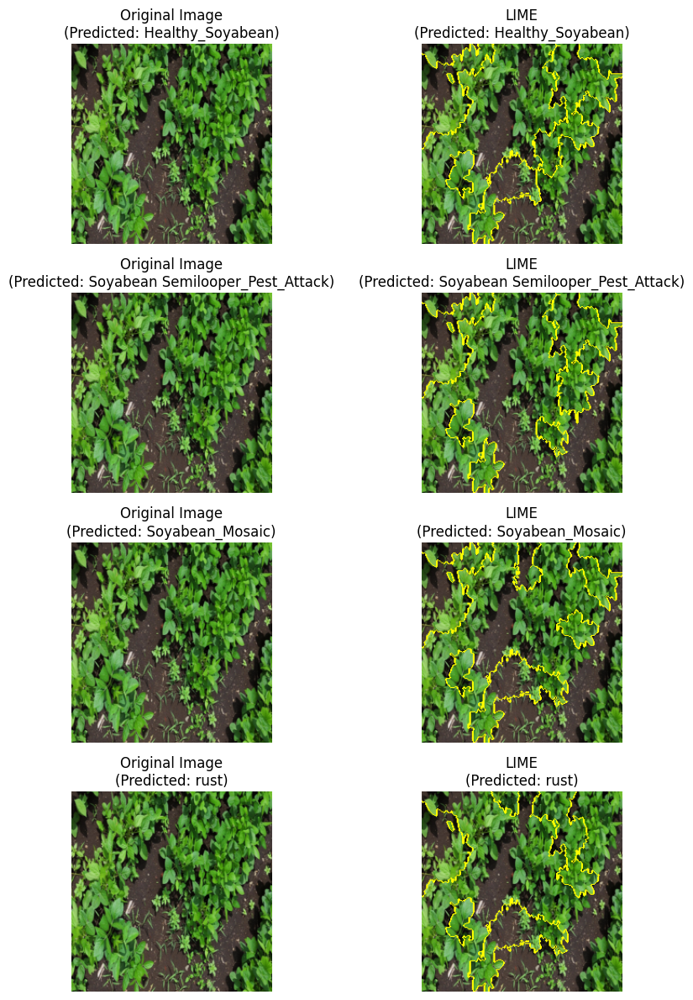

In [ ]:
from lime import lime_image
from skimage.segmentation import mark_boundaries
from PIL import Image
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from torchvision import transforms

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Define your dataset and transformations
# Assuming you already have a `dataset` and the required transformations (`transform_test`)
# If not, you can define them using the `transforms` module in torchvision.

# Assuming that `transform_test` is a transformation for testing, like:
# transform_test = transforms.Compose([transforms.Resize(224), transforms.ToTensor()])

# Load the fine-tuned ResNet-50 model
num_classes = len(class_names)
model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)
model.fc = nn.Linear(model.fc.in_features, num_classes)  # Adjust final layer
model.load_state_dict(torch.load("transfer_learning_resnet50.pth"))
model = model.to('cuda')
model.eval()

# Select a sample image from the dataset and preprocess it for display
sample_image, _ = dataset[0]  # Get the first image from the dataset
original_image_np = sample_image.permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)  # Ensure valid range [0, 1]

# Define a function to make predictions for LIME
def batch_predict(images):
    model.eval()
    # Convert numpy arrays to PIL images and apply transformations
    batch = torch.stack([transform_test(Image.fromarray((image * 255).astype(np.uint8))) for image in images], dim=0).to('cuda')
    with torch.no_grad():
        logits = model(batch)
    return logits.cpu().numpy()

# Initialize LIME explainer
explainer = lime_image.LimeImageExplainer()

# Create a subplot grid to show 2 columns (1 for original image and 1 for LIME explanations)
fig, axes = plt.subplots(nrows=num_classes, ncols=2, figsize=(10, num_classes * 3))  # Adjust the figure size for compactness

# Display the original image and LIME for each class
for target_class in range(num_classes):
    # Generate LIME explanation for the current class
    lime_explanation = explainer.explain_instance(
        original_image_np,  # Original image in numpy format
        batch_predict,      # Prediction function
        top_labels=1,       # Focus on the current class
        hide_color=0,
        num_samples=100     # Number of perturbed samples
    )

    # Get the top predicted class (in case of mismatch)
    top_label = lime_explanation.top_labels[0]

    # Get the image and mask for the predicted class
    lime_image, lime_mask = lime_explanation.get_image_and_mask(
        label=top_label,  # Use the top predicted label
        positive_only=True,
        hide_rest=False,
        num_features=10,
        min_weight=0.01
    )
    lime_image = mark_boundaries(lime_image, lime_mask)

    # Show the original image in the first column
    axes[target_class, 0].imshow(original_image_np)
    axes[target_class, 0].set_title(f"Original Image\n(Predicted: {class_names[target_class]})")
    axes[target_class, 0].axis("off")

    # Show the LIME explanation in the second column
    axes[target_class, 1].imshow(lime_image)
    axes[target_class, 1].set_title(f"LIME\n(Predicted: {class_names[target_class]})")
    axes[target_class, 1].axis("off")

# Adjust layout for better compactness
plt.tight_layout()
plt.show()


# Lime using vgg16

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

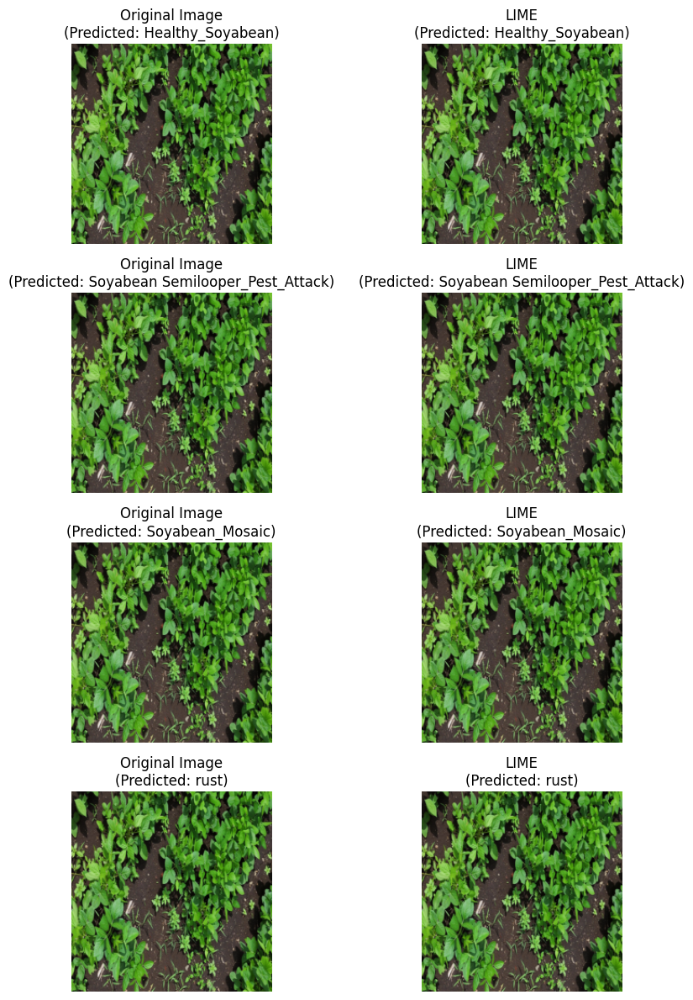

In [ ]:
from lime import lime_image
from skimage.segmentation import mark_boundaries
from PIL import Image
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from torchvision import transforms

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Define your dataset and transformations
# Assuming you already have a `dataset` and the required transformations (`transform_test`)
# If not, you can define them using the `transforms` module in torchvision.

# Assuming that `transform_test` is a transformation for testing, like:
# transform_test = transforms.Compose([transforms.Resize(224), transforms.ToTensor()])

# Load the fine-tuned VGG16 model
num_classes = len(class_names)
model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1)  # Load pre-trained VGG16
model.classifier[6] = nn.Linear(model.classifier[6].in_features, num_classes)  # Adjust final layer
model.load_state_dict(torch.load("transfer_learning_vgg16.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the dataset and preprocess it for display
sample_image, _ = dataset[0]  # Get the first image from the dataset
original_image_np = sample_image.permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)  # Ensure valid range [0, 1]

# Define a function to make predictions for LIME
def batch_predict(images):
    model.eval()
    # Convert numpy arrays to PIL images and apply transformations
    batch = torch.stack([transform_test(Image.fromarray((image * 255).astype(np.uint8))) for image in images], dim=0).to('cuda')
    with torch.no_grad():
        logits = model(batch)
    return logits.cpu().numpy()

# Initialize LIME explainer
explainer = lime_image.LimeImageExplainer()

# Create a subplot grid to show 5 columns (1 for original image and 4 for LIME explanations)
fig, axes = plt.subplots(nrows=num_classes, ncols=2, figsize=(10, num_classes * 3))  # Adjust the figure size for compactness

# Display the original image and LIME for each class
for target_class in range(num_classes):
    # Generate LIME explanation for the current class
    lime_explanation = explainer.explain_instance(
        original_image_np,  # Original image in numpy format
        batch_predict,      # Prediction function
        top_labels=1,       # Focus on the current class
        hide_color=0,
        num_samples=100     # Number of perturbed samples
    )

    # Get the top predicted class (in case of mismatch)
    top_label = lime_explanation.top_labels[0]

    # Get the image and mask for the predicted class
    lime_image, lime_mask = lime_explanation.get_image_and_mask(
        label=top_label,  # Use the top predicted label
        positive_only=True,
        hide_rest=False,
        num_features=10,
        min_weight=0.01
    )
    lime_image = mark_boundaries(lime_image, lime_mask)

    # Show the original image in the first column
    axes[target_class, 0].imshow(original_image_np)
    axes[target_class, 0].set_title(f"Original Image\n(Predicted: {class_names[target_class]})")
    axes[target_class, 0].axis("off")

    # Show the LIME explanation in the second column
    axes[target_class, 1].imshow(lime_image)
    axes[target_class, 1].set_title(f"LIME\n(Predicted: {class_names[target_class]})")
    axes[target_class, 1].axis("off")

# Adjust layout for better compactness
plt.tight_layout()
plt.show()


# Lime using mobilenet_v2

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

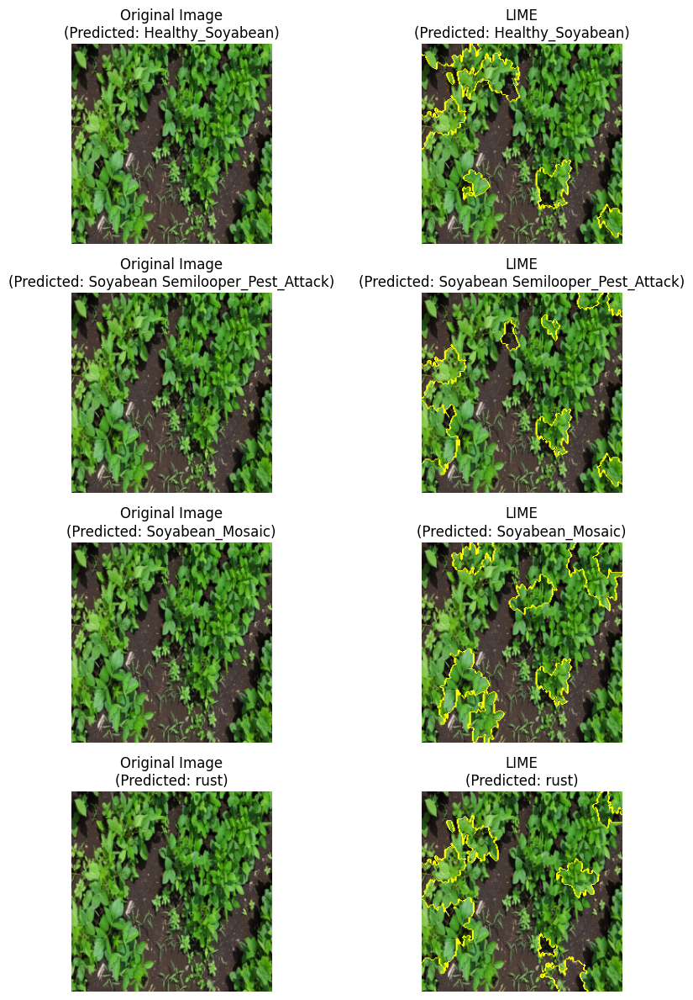

In [ ]:
from lime import lime_image
from skimage.segmentation import mark_boundaries
from PIL import Image
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from torchvision import transforms

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Define your dataset and transformations
# Assuming you already have a `dataset` and the required transformations (`transform_test`)
# If not, you can define them using the `transforms` module in torchvision.

# Assuming that `transform_test` is a transformation for testing, like:
# transform_test = transforms.Compose([transforms.Resize(224), transforms.ToTensor()])

# Load the fine-tuned MobileNetV2 model
num_classes = len(class_names)
model = models.mobilenet_v2(weights=models.MobileNet_V2_Weights.IMAGENET1K_V1)  # Load pre-trained MobileNetV2
model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)  # Adjust final layer
model.load_state_dict(torch.load("transfer_learning_mobilenet_v2.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the dataset and preprocess it for display
sample_image, _ = dataset[0]  # Get the first image from the dataset
original_image_np = sample_image.permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)  # Ensure valid range [0, 1]

# Define a function to make predictions for LIME
def batch_predict(images):
    model.eval()
    # Convert numpy arrays to PIL images and apply transformations
    batch = torch.stack([transform_test(Image.fromarray((image * 255).astype(np.uint8))) for image in images], dim=0).to('cuda')
    with torch.no_grad():
        logits = model(batch)
    return logits.cpu().numpy()

# Initialize LIME explainer
explainer = lime_image.LimeImageExplainer()

# Create a subplot grid to show 5 columns (1 for original image and 4 for LIME explanations)
fig, axes = plt.subplots(nrows=num_classes, ncols=2, figsize=(10, num_classes * 3))  # Adjust the figure size for compactness

# Display the original image and LIME for each class
for target_class in range(num_classes):
    # Generate LIME explanation for the current class
    lime_explanation = explainer.explain_instance(
        original_image_np,  # Original image in numpy format
        batch_predict,      # Prediction function
        top_labels=1,       # Focus on the current class
        hide_color=0,
        num_samples=100     # Number of perturbed samples
    )

    # Get the top predicted class (in case of mismatch)
    top_label = lime_explanation.top_labels[0]

    # Get the image and mask for the predicted class
    lime_image, lime_mask = lime_explanation.get_image_and_mask(
        label=top_label,  # Use the top predicted label
        positive_only=True,
        hide_rest=False,
        num_features=10,
        min_weight=0.01
    )
    lime_image = mark_boundaries(lime_image, lime_mask)

    # Show the original image in the first column
    axes[target_class, 0].imshow(original_image_np)
    axes[target_class, 0].set_title(f"Original Image\n(Predicted: {class_names[target_class]})")
    axes[target_class, 0].axis("off")

    # Show the LIME explanation in the second column
    axes[target_class, 1].imshow(lime_image)
    axes[target_class, 1].set_title(f"LIME\n(Predicted: {class_names[target_class]})")
    axes[target_class, 1].axis("off")

# Adjust layout for better compactness
plt.tight_layout()
plt.show()


# Lime using efficientnet_b3

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

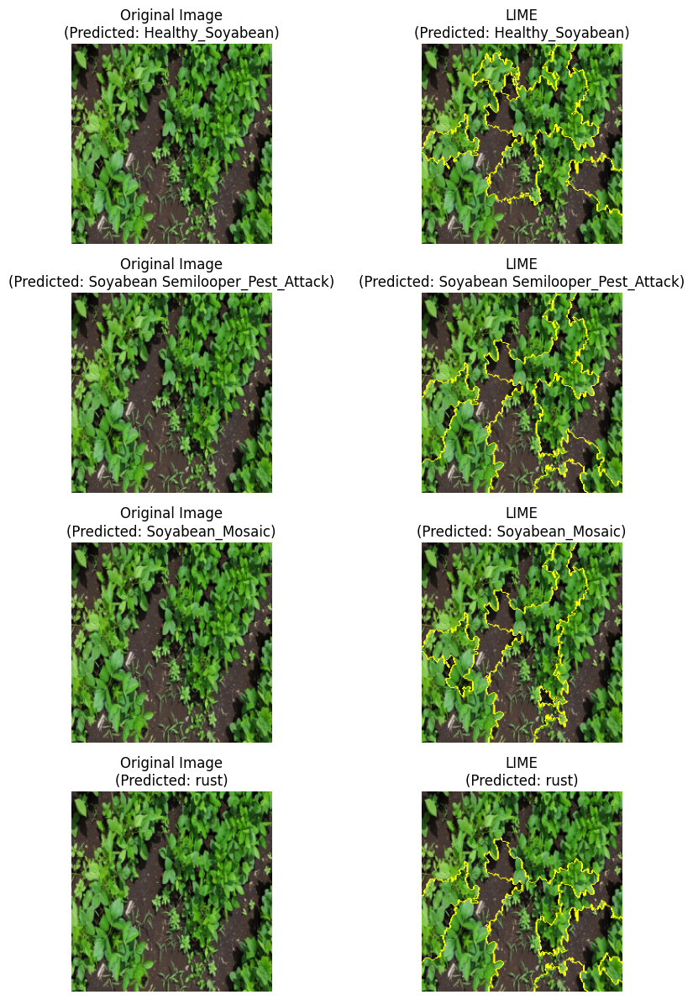

In [ ]:
from lime import lime_image
from skimage.segmentation import mark_boundaries
from PIL import Image
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from torchvision import transforms

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Define your dataset and transformations
# Assuming you already have a `dataset` and the required transformations (`transform_test`)
# If not, you can define them using the `transforms` module in torchvision.

# Assuming that `transform_test` is a transformation for testing, like:
# transform_test = transforms.Compose([transforms.Resize(224), transforms.ToTensor()])

# Load the fine-tuned EfficientNet-B3 model
num_classes = len(class_names)
model = models.efficientnet_b3(weights=models.EfficientNet_B3_Weights.IMAGENET1K_V1)  # Load pre-trained EfficientNet-B3
model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)  # Adjust final layer
model.load_state_dict(torch.load("transfer_learning_efficientnet_b3.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the dataset and preprocess it for display
sample_image, _ = dataset[0]  # Get the first image from the dataset
original_image_np = sample_image.permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)  # Ensure valid range [0, 1]

# Define a function to make predictions for LIME
def batch_predict(images):
    model.eval()
    # Convert numpy arrays to PIL images and apply transformations
    batch = torch.stack([transform_test(Image.fromarray((image * 255).astype(np.uint8))) for image in images], dim=0).to('cuda')
    with torch.no_grad():
        logits = model(batch)
    return logits.cpu().numpy()

# Initialize LIME explainer
explainer = lime_image.LimeImageExplainer()

# Create a subplot grid to show 5 columns (1 for original image and 4 for LIME explanations)
fig, axes = plt.subplots(nrows=num_classes, ncols=2, figsize=(10, num_classes * 3))  # Adjust the figure size for compactness

# Display the original image and LIME for each class
for target_class in range(num_classes):
    # Generate LIME explanation for the current class
    lime_explanation = explainer.explain_instance(
        original_image_np,  # Original image in numpy format
        batch_predict,      # Prediction function
        top_labels=1,       # Focus on the current class
        hide_color=0,
        num_samples=100     # Number of perturbed samples
    )

    # Get the top predicted class (in case of mismatch)
    top_label = lime_explanation.top_labels[0]

    # Get the image and mask for the predicted class
    lime_image, lime_mask = lime_explanation.get_image_and_mask(
        label=top_label,  # Use the top predicted label
        positive_only=True,
        hide_rest=False,
        num_features=10,
        min_weight=0.01
    )
    lime_image = mark_boundaries(lime_image, lime_mask)

    # Show the original image in the first column
    axes[target_class, 0].imshow(original_image_np)
    axes[target_class, 0].set_title(f"Original Image\n(Predicted: {class_names[target_class]})")
    axes[target_class, 0].axis("off")

    # Show the LIME explanation in the second column
    axes[target_class, 1].imshow(lime_image)
    axes[target_class, 1].set_title(f"LIME\n(Predicted: {class_names[target_class]})")
    axes[target_class, 1].axis("off")

# Adjust layout for better compactness
plt.tight_layout()
plt.show()


# Lime using densenet121

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

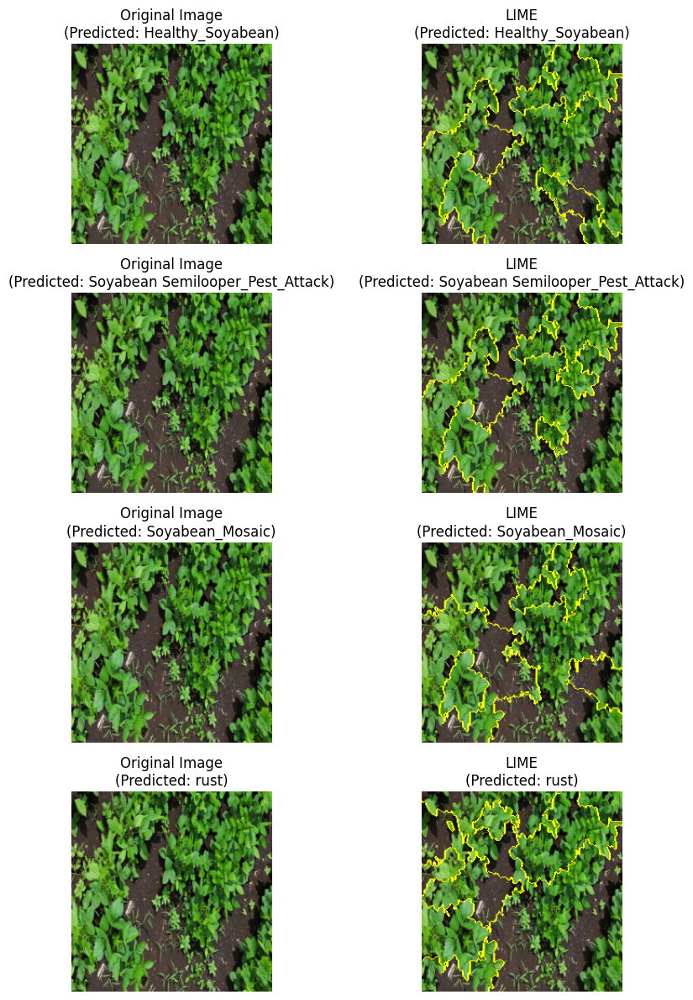

In [ ]:
from lime import lime_image
from skimage.segmentation import mark_boundaries
from PIL import Image
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from torchvision import transforms

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Define your dataset and transformations
# Assuming you already have a `dataset` and the required transformations (`transform_test`)
# If not, you can define them using the `transforms` module in torchvision.

# Assuming that `transform_test` is a transformation for testing, like:
# transform_test = transforms.Compose([transforms.Resize(224), transforms.ToTensor()])

# Load the fine-tuned DenseNet121 model
num_classes = len(class_names)
model = models.densenet121(weights=models.DenseNet121_Weights.IMAGENET1K_V1)  # Load pre-trained DenseNet121
model.classifier = nn.Linear(model.classifier.in_features, num_classes)  # Adjust final layer
model.load_state_dict(torch.load("transfer_learning_densenet121.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the dataset and preprocess it for display
sample_image, _ = dataset[0]  # Get the first image from the dataset
original_image_np = sample_image.permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)  # Ensure valid range [0, 1]

# Define a function to make predictions for LIME
def batch_predict(images):
    model.eval()
    # Convert numpy arrays to PIL images and apply transformations
    batch = torch.stack([transform_test(Image.fromarray((image * 255).astype(np.uint8))) for image in images], dim=0).to('cuda')
    with torch.no_grad():
        logits = model(batch)
    return logits.cpu().numpy()

# Initialize LIME explainer
explainer = lime_image.LimeImageExplainer()

# Create a subplot grid to show 5 columns (1 for original image and 4 for LIME explanations)
fig, axes = plt.subplots(nrows=num_classes, ncols=2, figsize=(10, num_classes * 3))  # Adjust the figure size for compactness

# Display the original image and LIME for each class
for target_class in range(num_classes):
    # Generate LIME explanation for the current class
    lime_explanation = explainer.explain_instance(
        original_image_np,  # Original image in numpy format
        batch_predict,      # Prediction function
        top_labels=1,       # Focus on the current class
        hide_color=0,
        num_samples=100     # Number of perturbed samples
    )

    # Get the top predicted class (in case of mismatch)
    top_label = lime_explanation.top_labels[0]

    # Get the image and mask for the predicted class
    lime_image, lime_mask = lime_explanation.get_image_and_mask(
        label=top_label,  # Use the top predicted label
        positive_only=True,
        hide_rest=False,
        num_features=10,
        min_weight=0.01
    )
    lime_image = mark_boundaries(lime_image, lime_mask)

    # Show the original image in the first column
    axes[target_class, 0].imshow(original_image_np)
    axes[target_class, 0].set_title(f"Original Image\n(Predicted: {class_names[target_class]})")
    axes[target_class, 0].axis("off")

    # Show the LIME explanation in the second column
    axes[target_class, 1].imshow(lime_image)
    axes[target_class, 1].set_title(f"LIME\n(Predicted: {class_names[target_class]})")
    axes[target_class, 1].axis("off")

# Adjust layout for better compactness
plt.tight_layout()
plt.show()


# Lime using resnet152

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

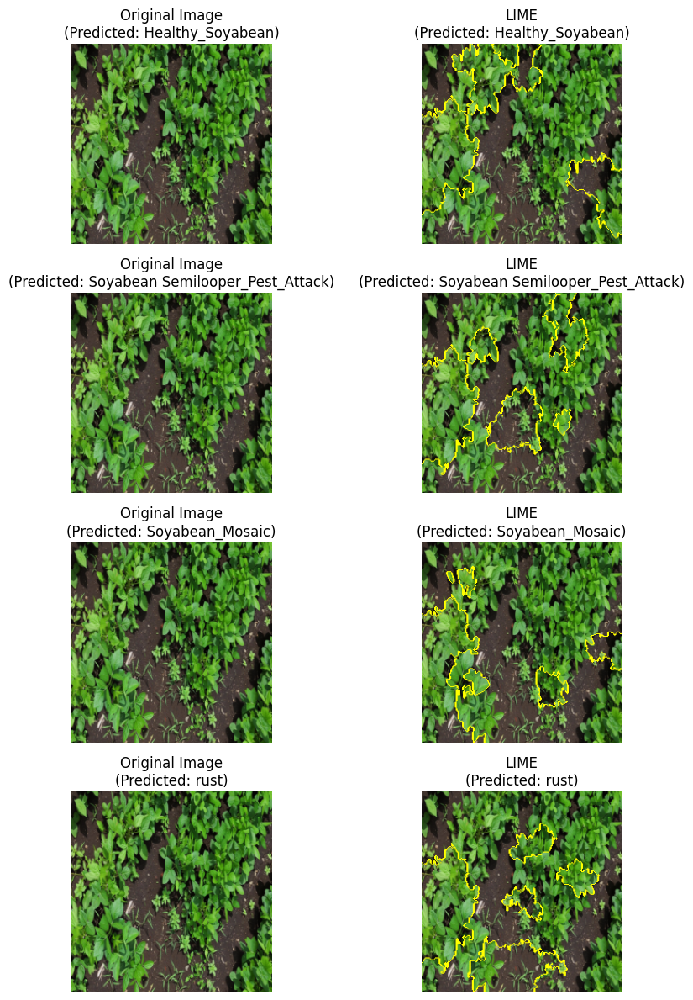

In [ ]:
from lime import lime_image
from skimage.segmentation import mark_boundaries
from PIL import Image
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from torchvision import transforms

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Define your dataset and transformations
# Assuming you already have a `dataset` and the required transformations (`transform_test`)
# If not, you can define them using the `transforms` module in torchvision.

# Assuming that `transform_test` is a transformation for testing, like:
# transform_test = transforms.Compose([transforms.Resize(224), transforms.ToTensor()])

# Load the fine-tuned ResNet152 model
num_classes = len(class_names)
model = models.resnet152(weights=models.ResNet152_Weights.IMAGENET1K_V1)  # Load pre-trained ResNet152
model.fc = nn.Linear(model.fc.in_features, num_classes)  # Adjust final layer to match number of classes
model.load_state_dict(torch.load("transfer_learning_resnet152.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the dataset and preprocess it for display
sample_image, _ = dataset[0]  # Get the first image from the dataset
original_image_np = sample_image.permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)  # Ensure valid range [0, 1]

# Define a function to make predictions for LIME
def batch_predict(images):
    model.eval()
    # Convert numpy arrays to PIL images and apply transformations
    batch = torch.stack([transform_test(Image.fromarray((image * 255).astype(np.uint8))) for image in images], dim=0).to('cuda')
    with torch.no_grad():
        logits = model(batch)
    return logits.cpu().numpy()

# Initialize LIME explainer
explainer = lime_image.LimeImageExplainer()

# Create a subplot grid to show 5 columns (1 for original image and 4 for LIME explanations)
fig, axes = plt.subplots(nrows=num_classes, ncols=2, figsize=(10, num_classes * 3))  # Adjust the figure size for compactness

# Display the original image and LIME for each class
for target_class in range(num_classes):
    # Generate LIME explanation for the current class
    lime_explanation = explainer.explain_instance(
        original_image_np,  # Original image in numpy format
        batch_predict,      # Prediction function
        top_labels=1,       # Focus on the current class
        hide_color=0,
        num_samples=100     # Number of perturbed samples
    )

    # Get the top predicted class (in case of mismatch)
    top_label = lime_explanation.top_labels[0]

    # Get the image and mask for the predicted class
    lime_image, lime_mask = lime_explanation.get_image_and_mask(
        label=top_label,  # Use the top predicted label
        positive_only=True,
        hide_rest=False,
        num_features=10,
        min_weight=0.01
    )
    lime_image = mark_boundaries(lime_image, lime_mask)

    # Show the original image in the first column
    axes[target_class, 0].imshow(original_image_np)
    axes[target_class, 0].set_title(f"Original Image\n(Predicted: {class_names[target_class]})")
    axes[target_class, 0].axis("off")

    # Show the LIME explanation in the second column
    axes[target_class, 1].imshow(lime_image)
    axes[target_class, 1].set_title(f"LIME\n(Predicted: {class_names[target_class]})")
    axes[target_class, 1].axis("off")

# Adjust layout for better compactness
plt.tight_layout()
plt.show()


# Lime using densenet201

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

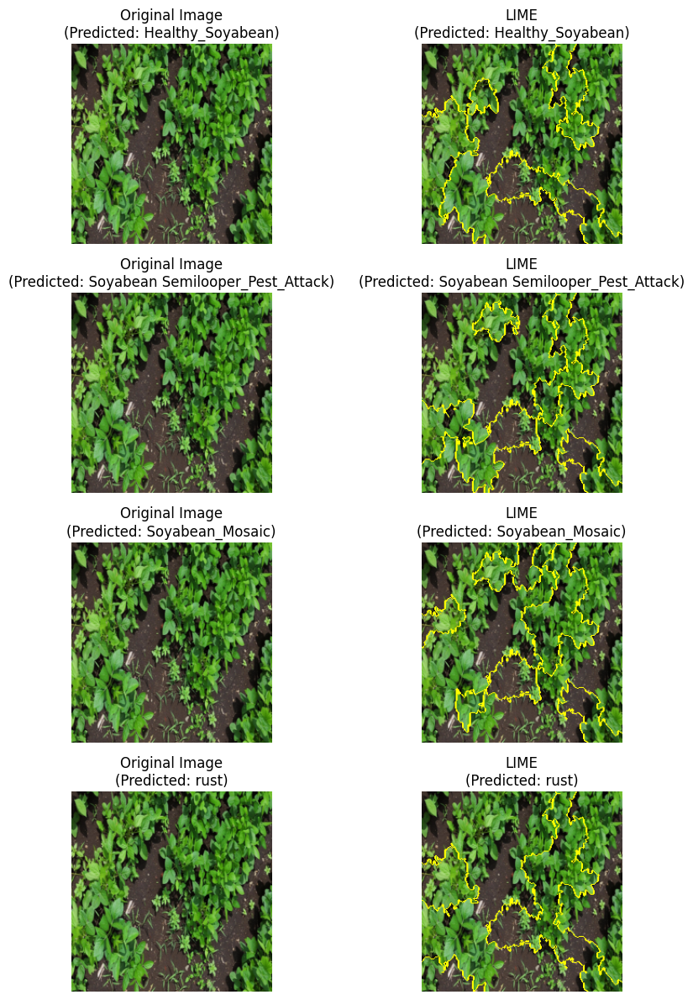

In [ ]:
from lime import lime_image
from skimage.segmentation import mark_boundaries
from PIL import Image
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import models
from torchvision import transforms

# Class names in order
class_names = ['Healthy_Soyabean', 'Soyabean Semilooper_Pest_Attack', 'Soyabean_Mosaic', 'rust']

# Load the fine-tuned DenseNet201 model
num_classes = len(class_names)
model = models.densenet201(weights=models.DenseNet201_Weights.IMAGENET1K_V1)  # Load pre-trained DenseNet201
model.classifier = nn.Linear(model.classifier.in_features, num_classes)  # Adjust classifier layer for DenseNet
model.load_state_dict(torch.load("transfer_learning_densenet201.pth", weights_only=True))  # Load fine-tuned weights
model = model.to('cuda')
model.eval()

# Select a sample image from the dataset and preprocess it for display
sample_image, _ = dataset[0]  # Get the first image from the dataset
original_image_np = sample_image.permute(1, 2, 0).cpu().numpy()
original_image_np = (original_image_np * 0.5) + 0.5  # Unnormalize
original_image_np = np.clip(original_image_np, 0, 1)  # Ensure valid range [0, 1]

# Define a function to make predictions for LIME
def batch_predict(images):
    model.eval()
    # Convert numpy arrays to PIL images and apply transformations
    batch = torch.stack([transform_test(Image.fromarray((image * 255).astype(np.uint8))) for image in images], dim=0).to('cuda')
    with torch.no_grad():
        logits = model(batch)
    return logits.cpu().numpy()

# Initialize LIME explainer
explainer = lime_image.LimeImageExplainer()

# Create a subplot grid to show 2 columns (1 for original image and 1 for LIME explanations)
fig, axes = plt.subplots(nrows=num_classes, ncols=2, figsize=(10, num_classes * 3))  # Adjust the figure size for compactness

# Display the original image and LIME for each class
for target_class in range(num_classes):
    # Generate LIME explanation for the current class
    lime_explanation = explainer.explain_instance(
        original_image_np,  # Original image in numpy format
        batch_predict,      # Prediction function
        top_labels=1,       # Focus on the current class
        hide_color=0,
        num_samples=100     # Number of perturbed samples
    )

    # Get the top predicted class (in case of mismatch)
    top_label = lime_explanation.top_labels[0]

    # Get the image and mask for the predicted class
    lime_image, lime_mask = lime_explanation.get_image_and_mask(
        label=top_label,  # Use the top predicted label
        positive_only=True,
        hide_rest=False,
        num_features=10,
        min_weight=0.01
    )
    lime_image = mark_boundaries(lime_image, lime_mask)

    # Show the original image in the first column
    axes[target_class, 0].imshow(original_image_np)
    axes[target_class, 0].set_title(f"Original Image\n(Predicted: {class_names[target_class]})")
    axes[target_class, 0].axis("off")

    # Show the LIME explanation in the second column
    axes[target_class, 1].imshow(lime_image)
    axes[target_class, 1].set_title(f"LIME\n(Predicted: {class_names[target_class]})")
    axes[target_class, 1].axis("off")

# Adjust layout for better compactness
plt.tight_layout()
plt.show()